## Example eye tracking plots using edfprocessor.py
- plots of fixations on individual trials
- plots of fixations on individual trials with arrows indicating fixation order
- plots of fixations across trials
- summary statistics fixations in a binary choice task

In [1]:
import os
import sys
import math
import pandas as pd
import scipy.stats as stats
import seaborn as sns
import numpy as np
import scipy
import pickle
import datetime
from statistics import mean
import matplotlib as mpl
import matplotlib.pyplot as plt
import traceback

import edfprocessor

In [2]:
sns.set(style="ticks", color_codes=True)
flatui = ["#95a5a6", "#3498db", "#9b59b6", "#e74c3c", "#34495e", "#2ecc71"]
sns.set_palette(flatui)
colors = sns.color_palette(flatui)
mpl.rcParams['figure.dpi']= 180

In [3]:
subs = os.listdir('./data_copy')
subs.sort()
for subjid in subs:
    # think/no-think
    asc_name = os.path.join('data_copy','TNTVD',subjid,subjid+'_thinknothink.asc')
    csv_name = os.path.join('data_copy','TNTVD',subjid,subjid+'_thinknothink_eye_movements.csv')
    if os.path.exists(asc_name) and not os.path.exists(csv_name):
        try:
            edfprocessor.write_fixation_data_to_csv(asc_name,csv_name,'TRIALID','CUE ON')
        except:
            traceback.print_exc()
            print("error with", asc_name, csv_name)

    asc_name = os.path.join('data_copy','TNTVD',subjid,subjid+'_thinknothink.asc')
    csv_name = os.path.join('data_copy','TNTVD',subjid,subjid+'_thinknothink_eye_movements_during_cue_presentation.csv')
    if os.path.exists(asc_name) and not os.path.exists(csv_name):
        try:
            edfprocessor.write_fixation_data_to_csv(asc_name,csv_name,'CUE ON','ITI STARTING')
        except:
            traceback.print_exc()
            print("error with ", asc_name, csv_name)

    # food choice
    asc_name = os.path.join('data_copy','TNTVD',subjid,subjid+'_foodchoice.asc') 
    csv_name = os.path.join('data_copy','TNTVD',subjid,subjid+'_food_choice_eye_movements.csv')

    if os.path.exists(asc_name) and not os.path.exists(csv_name):
        try:
            edfprocessor.write_fixation_data_to_csv(asc_name,csv_name,'TRIALID','TRIAL_RESULT')
        except:
            traceback.print_exc()
            print("error with ", asc_name, csv_name)

In [4]:
df = pd.read_csv('./data_copy/allfixationdatawithchoices.csv')
df = df.loc[df['duration']!=0] # remove "fixations" without recorded fixations on targeted stimuli

In [5]:
df.columns

Index(['Unnamed: 0_x', 'avg x pos', 'avg y pos', 'duration',
       'fix on left_food_stimulus', 'fix on right_food_stimulus', 'index',
       'subjid', 'trialN', 'type', 'Unnamed: 0_y', 'leftStim',
       'leftStimRating', 'rightStim', 'rightStimRating', 'choseright', 'rt',
       'choiceCondition', 'rightStimCondition', 'leftStimCondition',
       'rightStimRating_z', 'leftStimRating_z', 'deltaval', 'deltaval_z',
       'absdeltaval_z', 'condition'],
      dtype='object')

In [6]:
subjids = df['subjid'].unique()

In [7]:
len(subjids)

33

In [8]:
allEyeData = {}
for subjid in subjids:
    eyedata = edfprocessor.process_edf(
        './data_copy/%s/%s_foodchoice.asc'%(subjid,subjid),
        trial_marker_start='TRIALID',
        trial_marker_end='TRIAL_RESULT')
    allEyeData[subjid] = eyedata

Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
Data processing completed.
Processing asc file now...
D

## data quality check

### plot all fixations during each trial for one subject (without fixation arrows)

In [9]:
example = allEyeData['tnt001'].fixationData
example.loc[example['trialN']==0]

,duration,avg x pos,avg y pos,type,fix on left_food_stimulus,fix on right_food_stimulus,trialN
0,39.0,852.9,363.0,started before trial,False,False,0
1,85.0,894.1,480.9,started and ended during trial,False,False,0
2,223.0,429.9,510.9,started and ended during trial,True,False,0
3,133.0,542.4,512.6,started and ended during trial,True,False,0
4,358.0,1424.1,479.8,started and ended during trial,False,True,0
5,255.0,481.1,544.1,started and ended during trial,True,False,0
6,1098.0,537.5,483.9,ended after trial,True,False,0


Plotting fixations now...


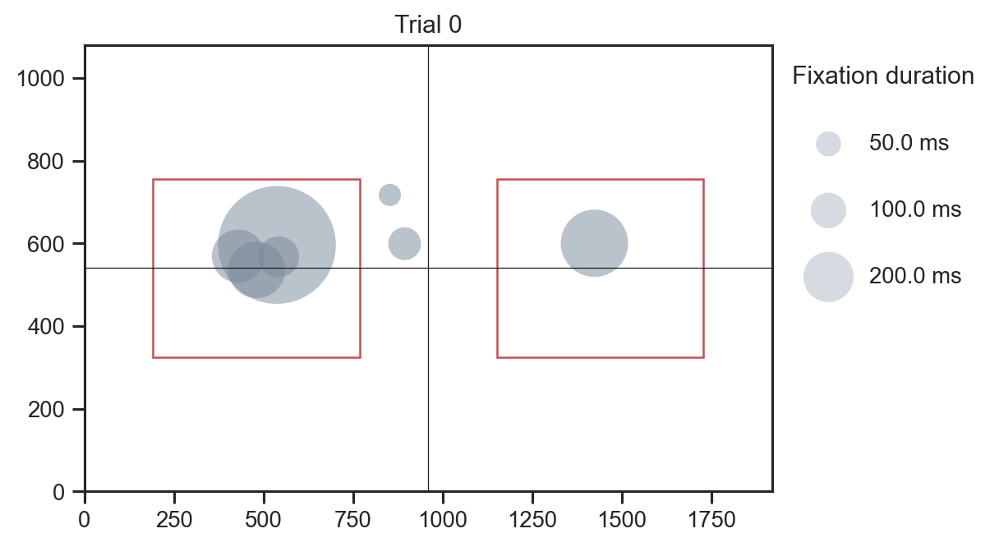

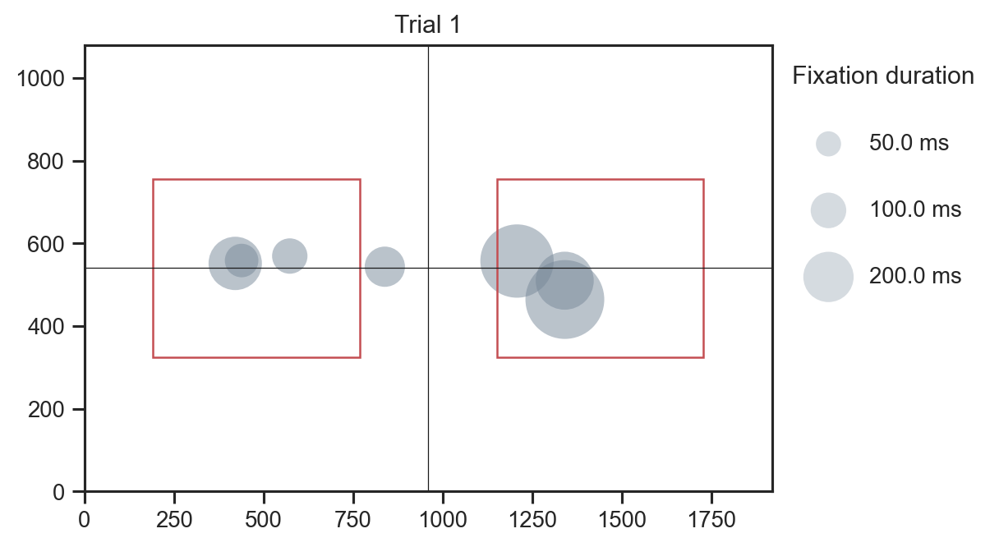

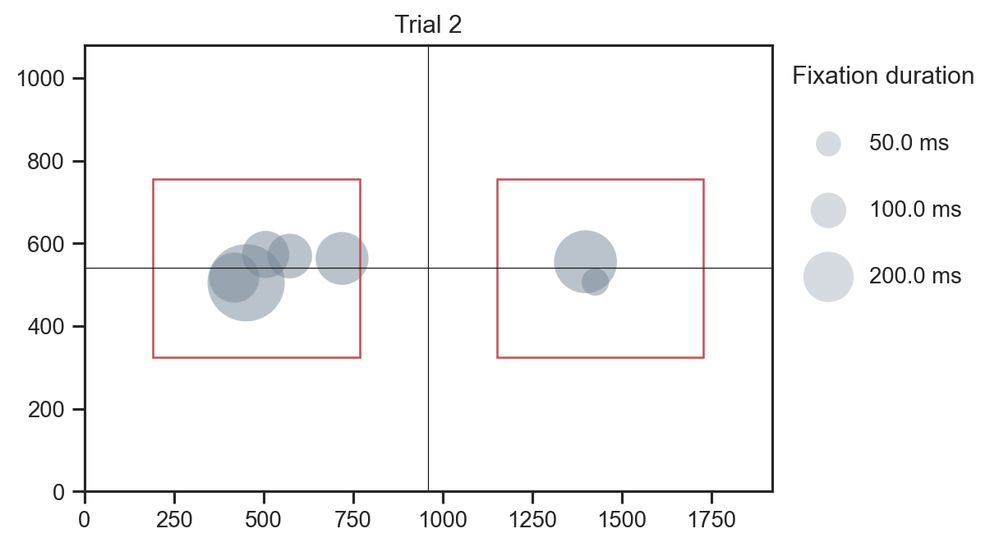

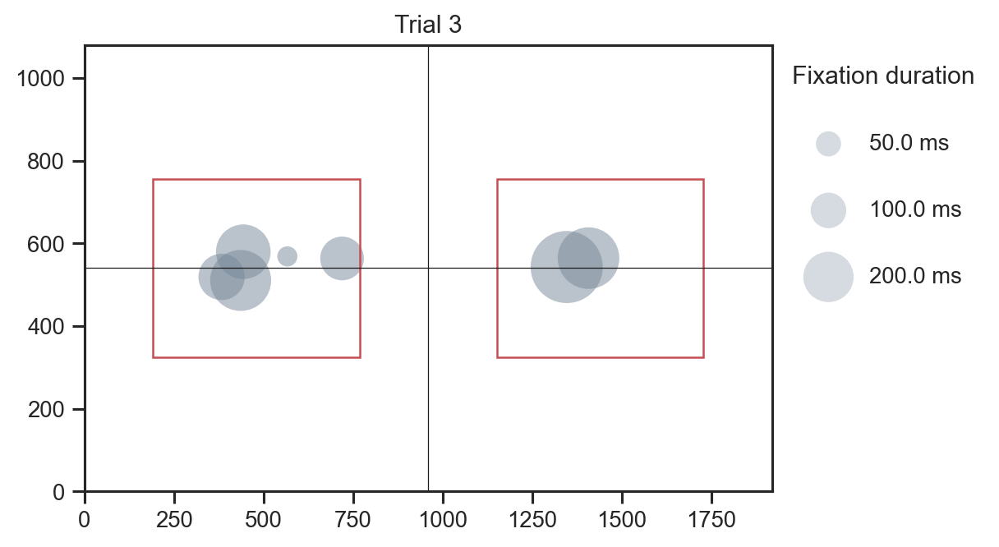

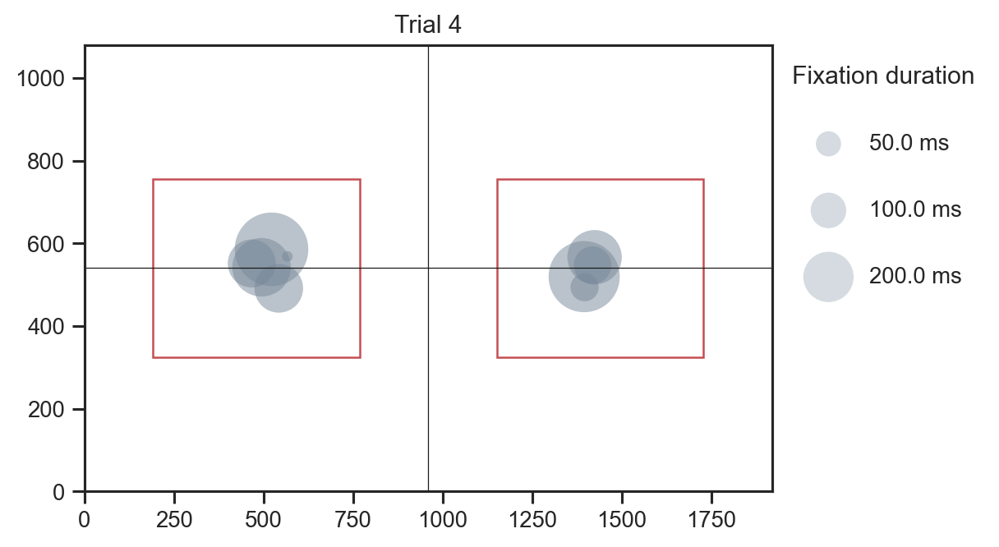

...

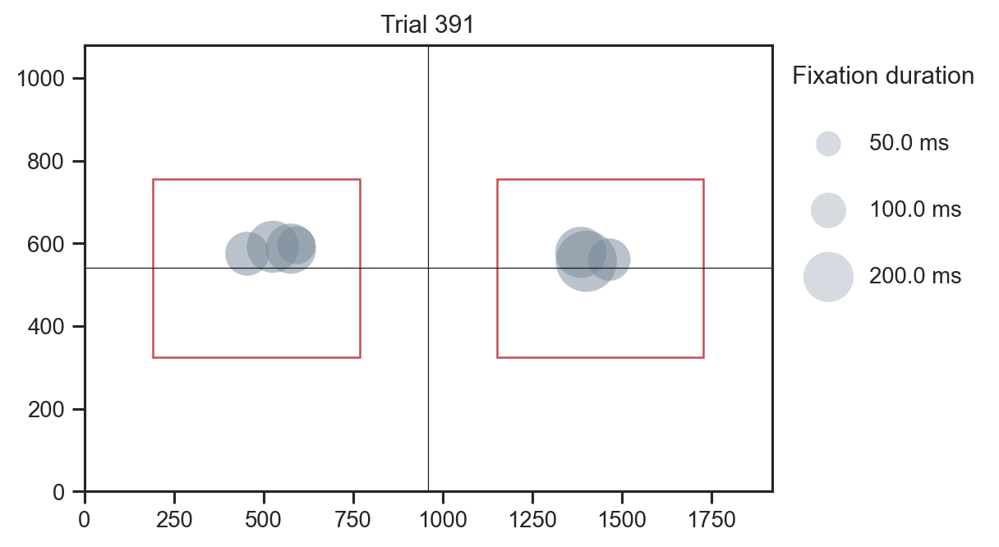

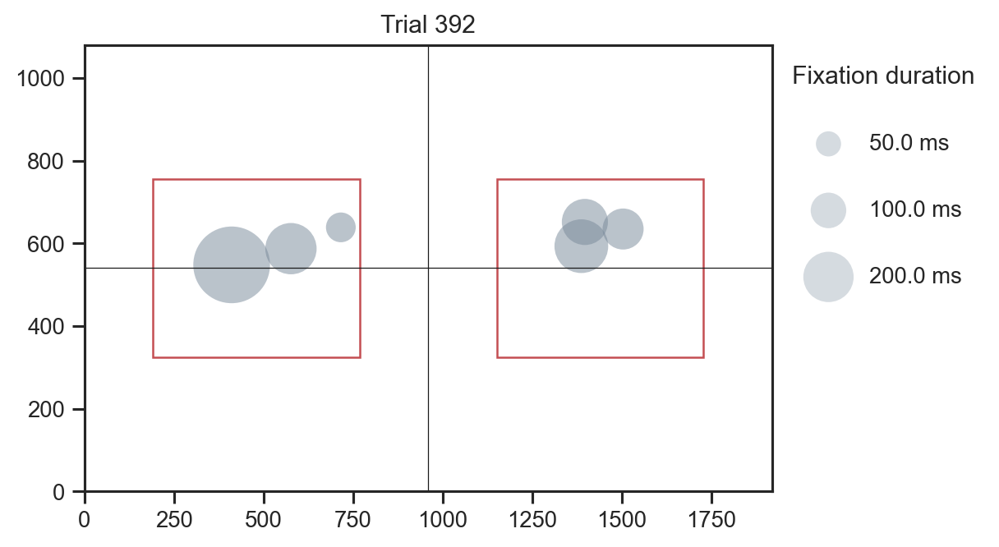

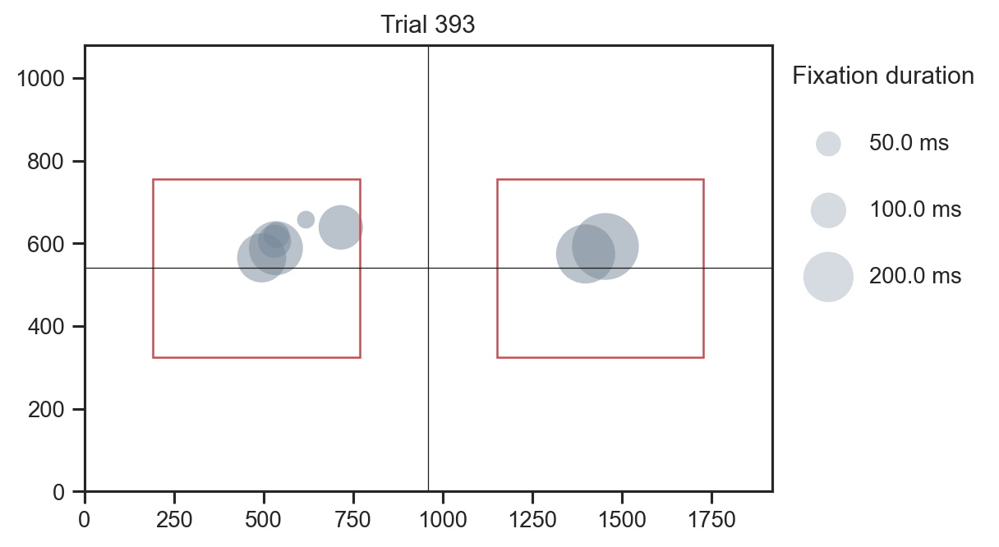

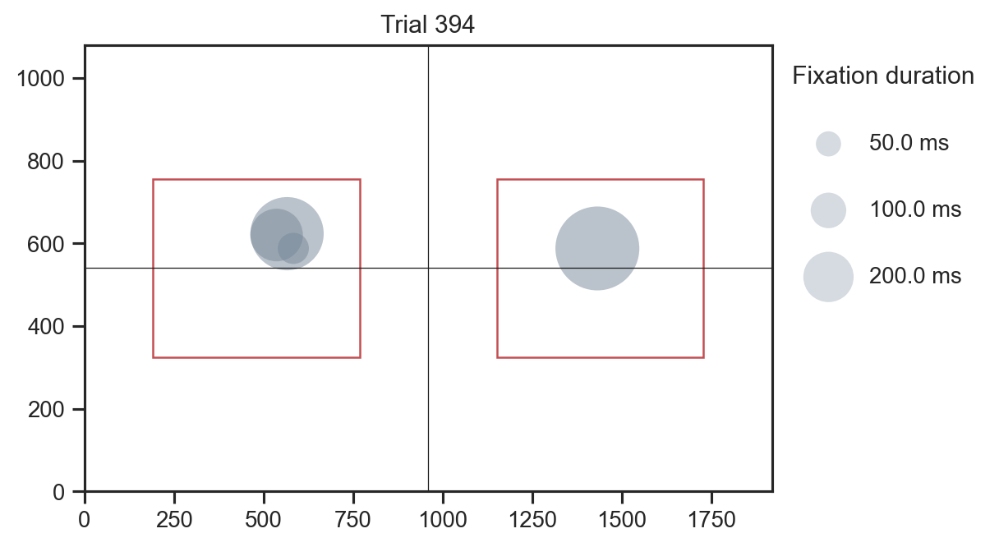

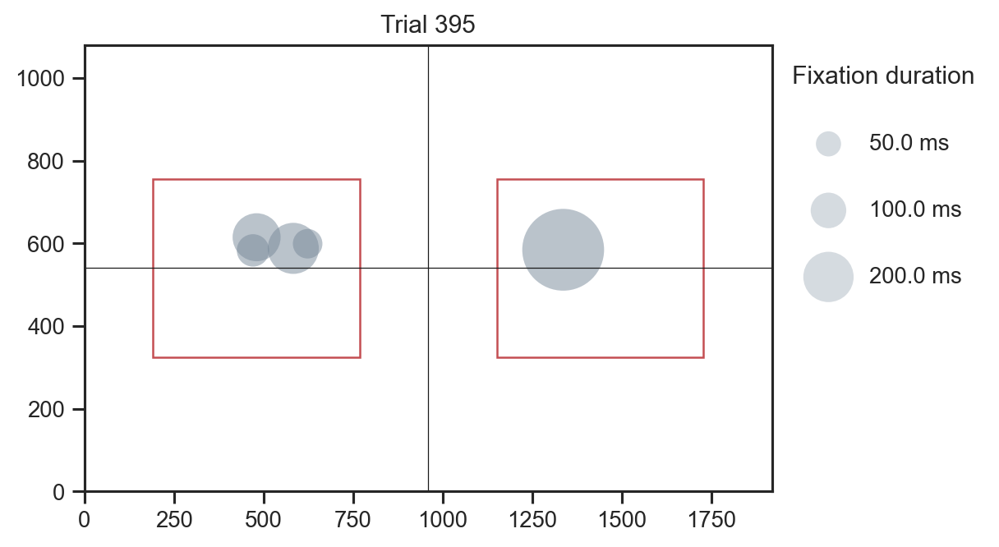

In [10]:
for subjid in subjids[0:1]:
    eyedata = allEyeData[subjid]
    edfprocessor.plot_trial_fixations(eyedata)

### plot all fixations with arrows indicating eye movements between fixations

Plotting fixations now...


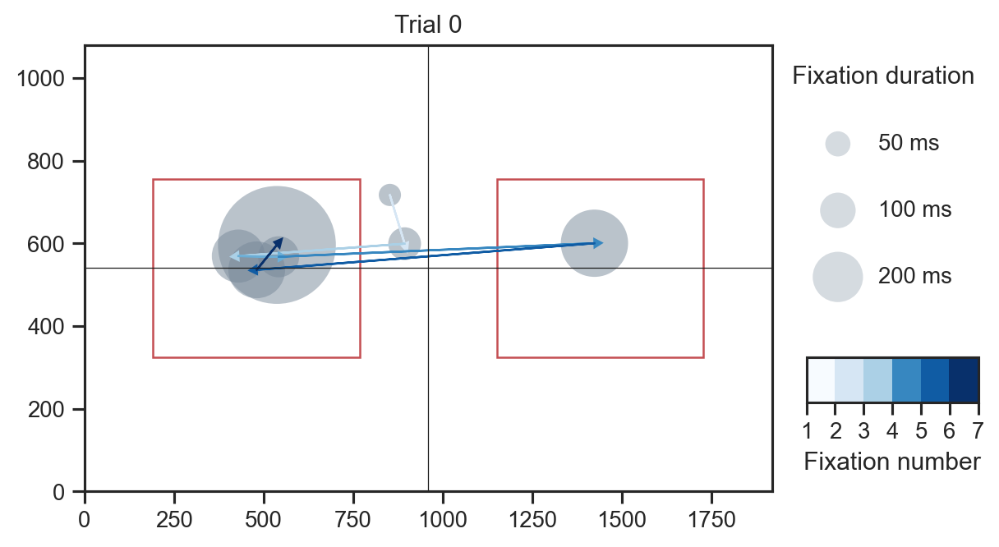

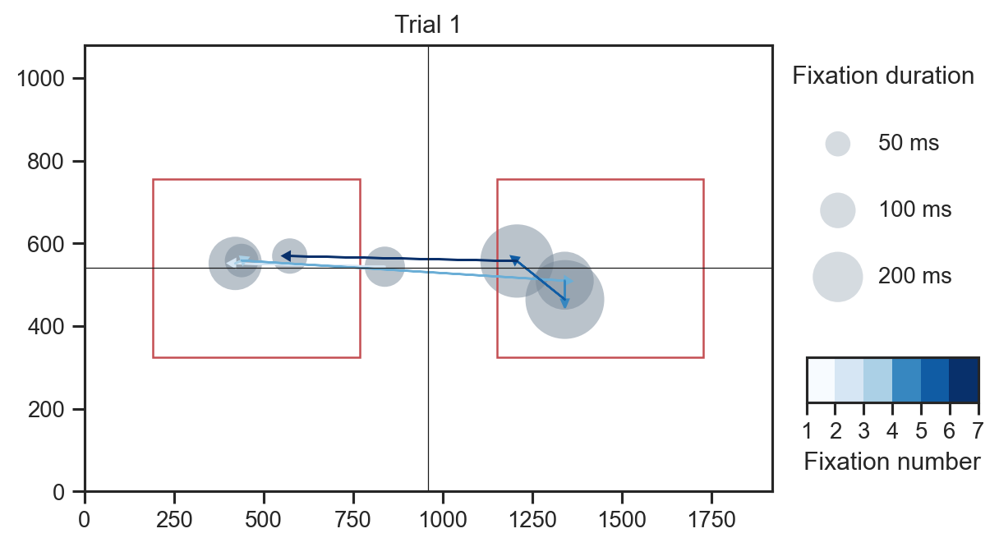

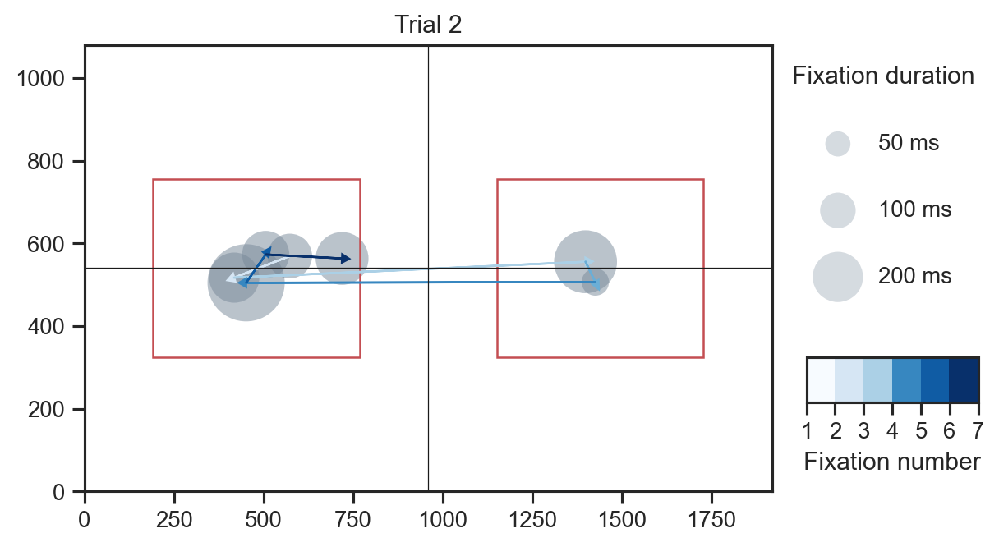

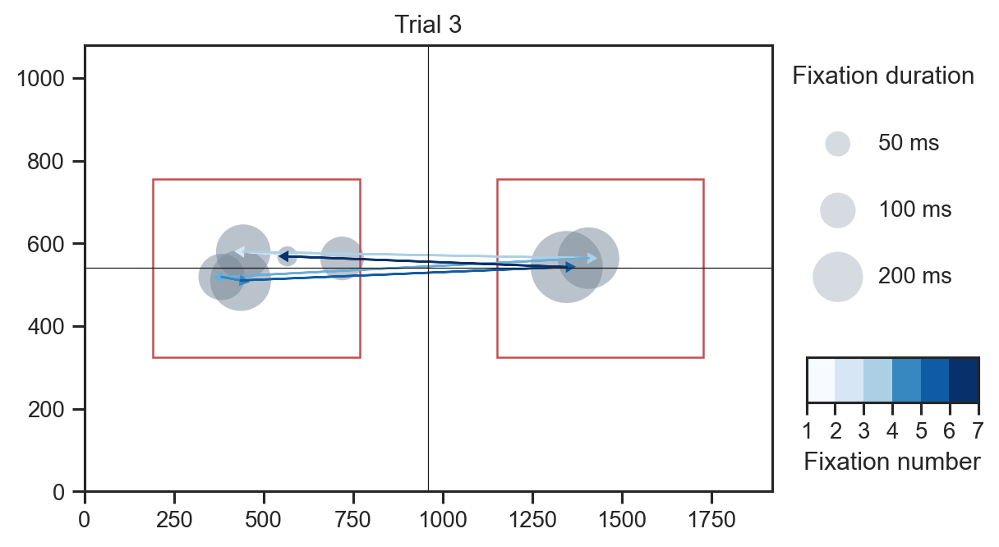

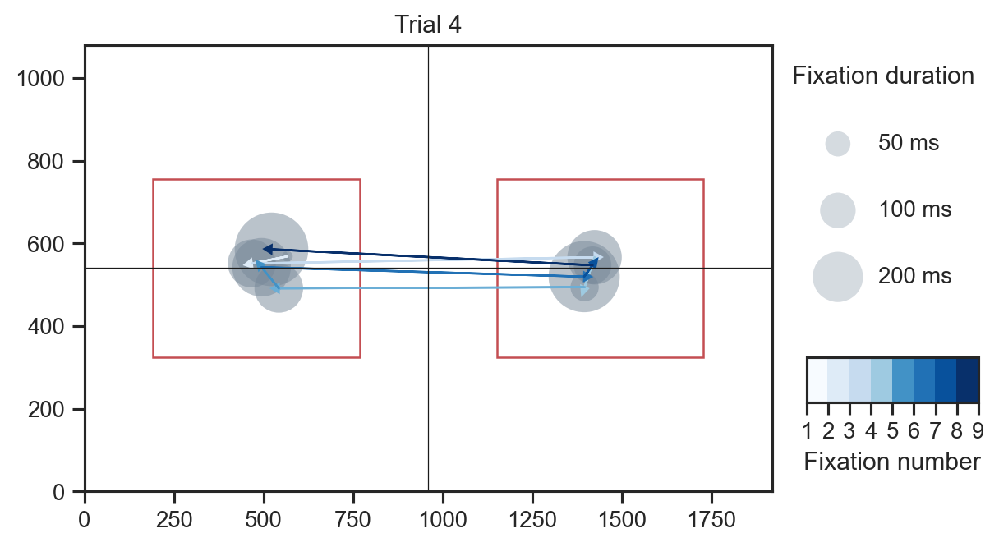

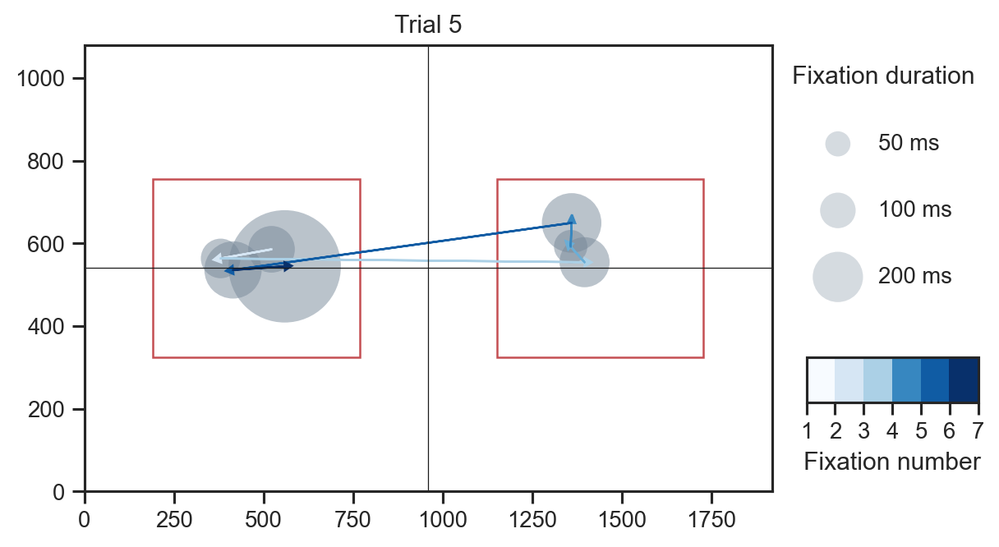

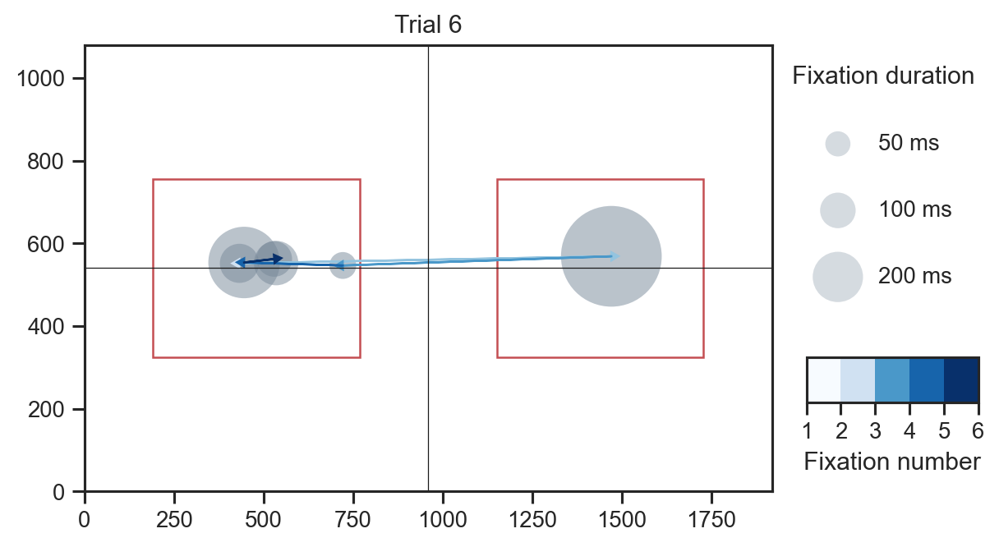

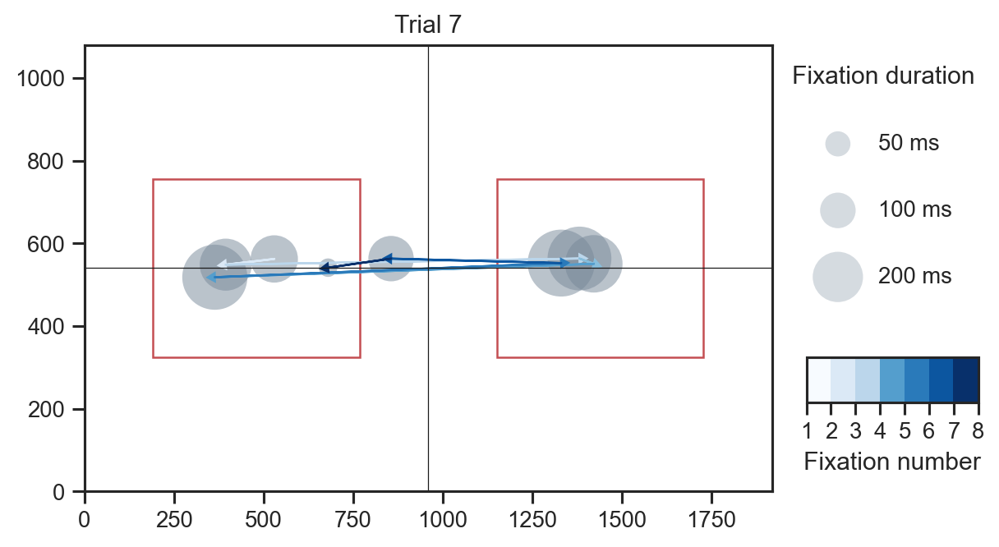

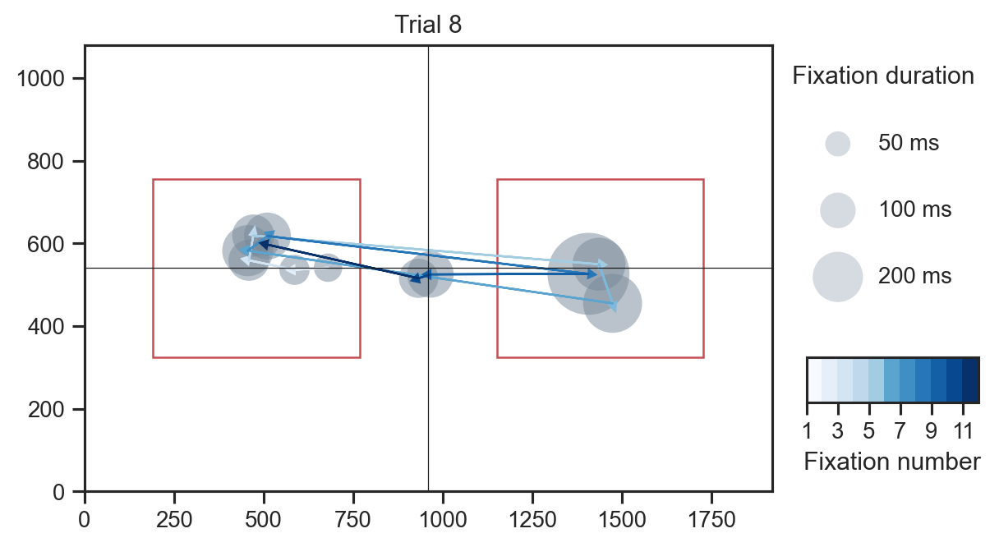

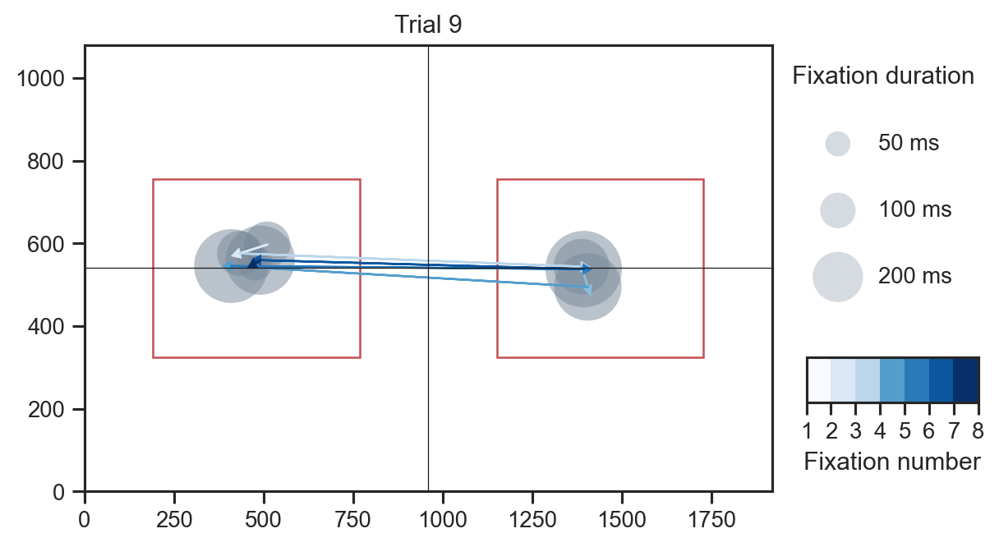

In [11]:
# just plot 10 trials for demo purposes
eyedata1 = allEyeData[subjids[0]]
eyedata1.fixationData = eyedata1.fixationData.loc[eyedata1.fixationData['trialN']<10]
edfprocessor.plot_ordered_trial_fixations(eyedata1)

### plot all fixations across all trials for each subject

Plotting fixations now...


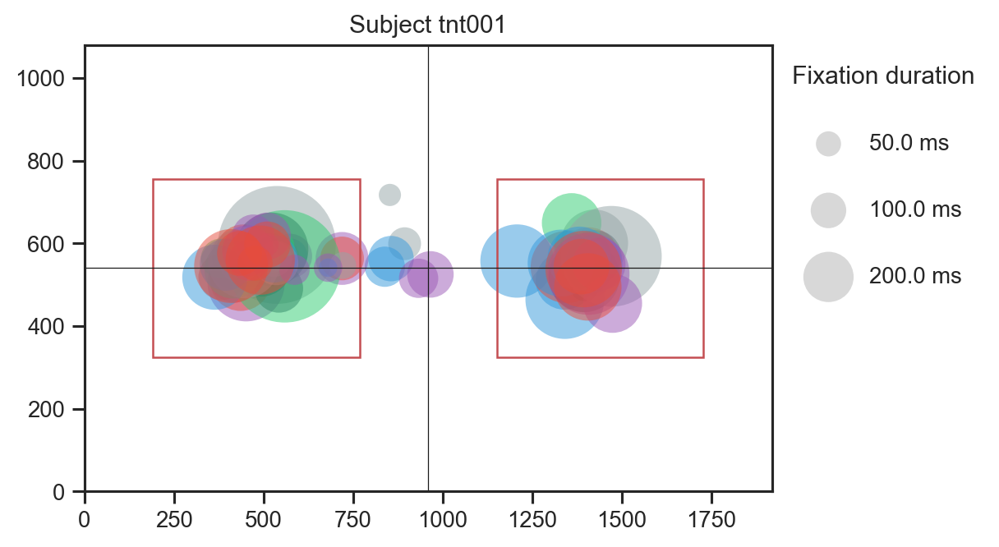

Plotting fixations now...


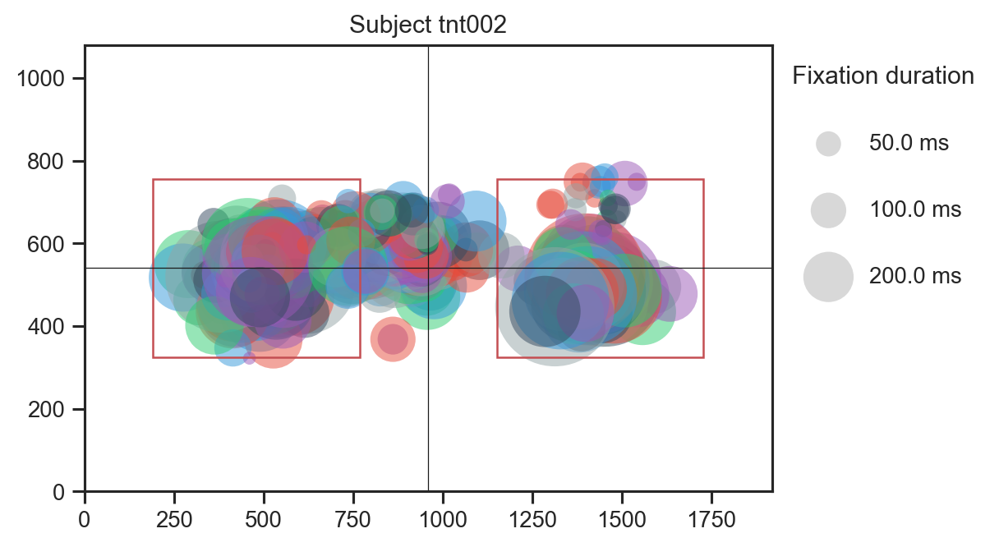

Plotting fixations now...


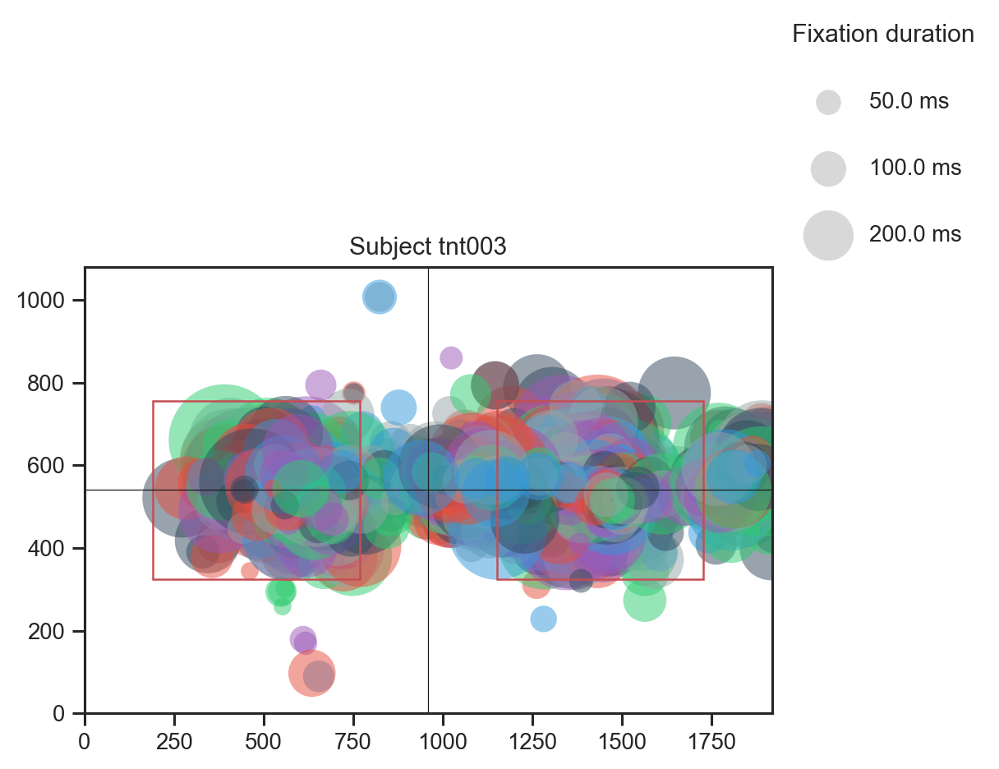

Plotting fixations now...


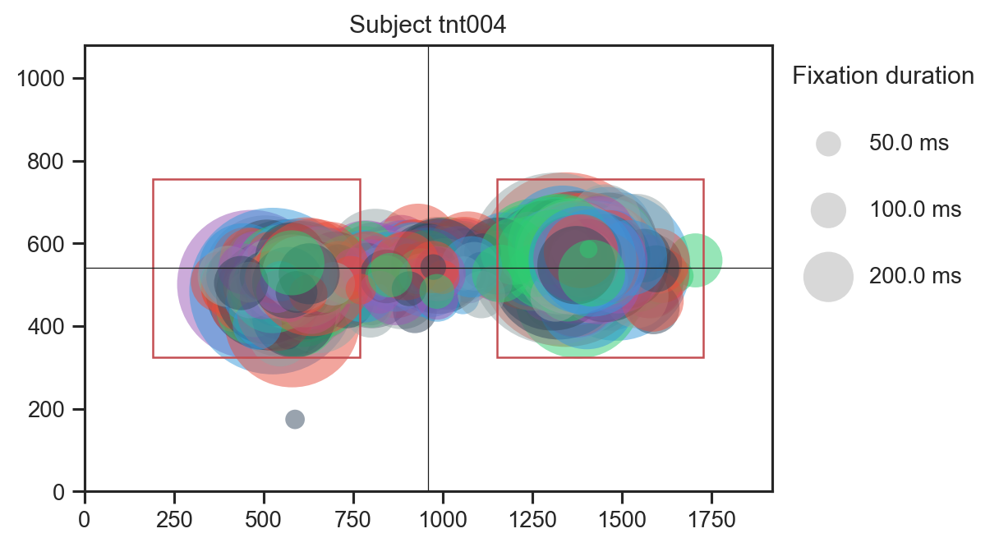

Plotting fixations now...


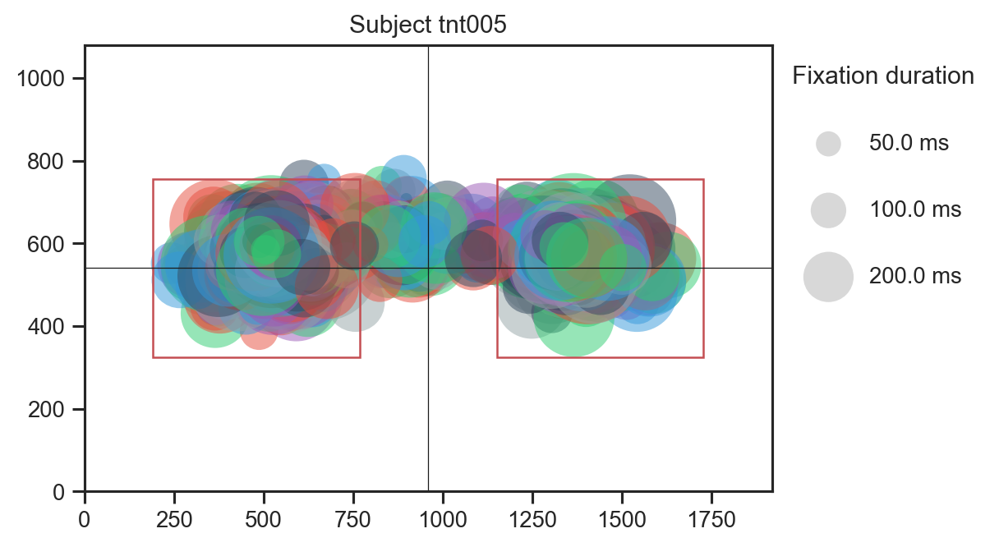

Plotting fixations now...


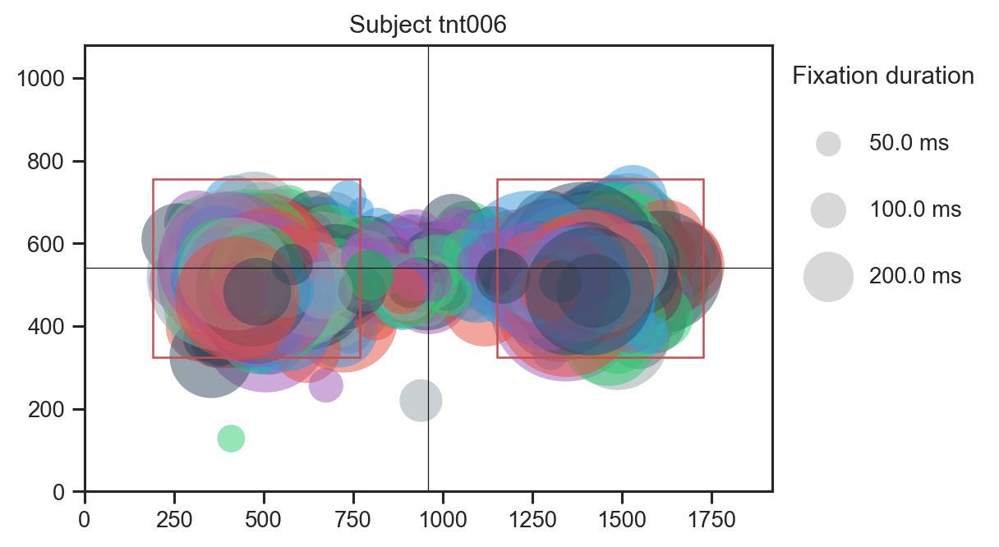

Plotting fixations now...


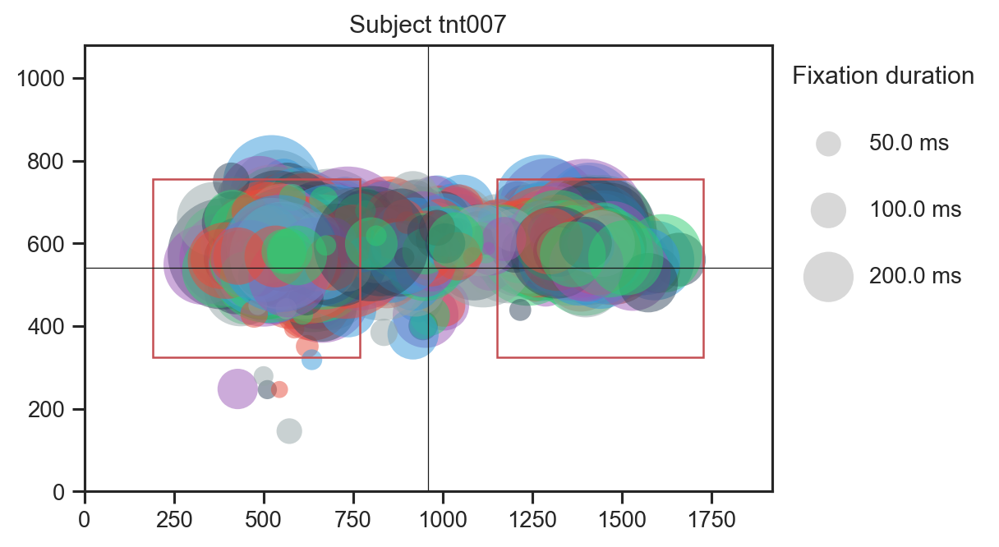

Plotting fixations now...


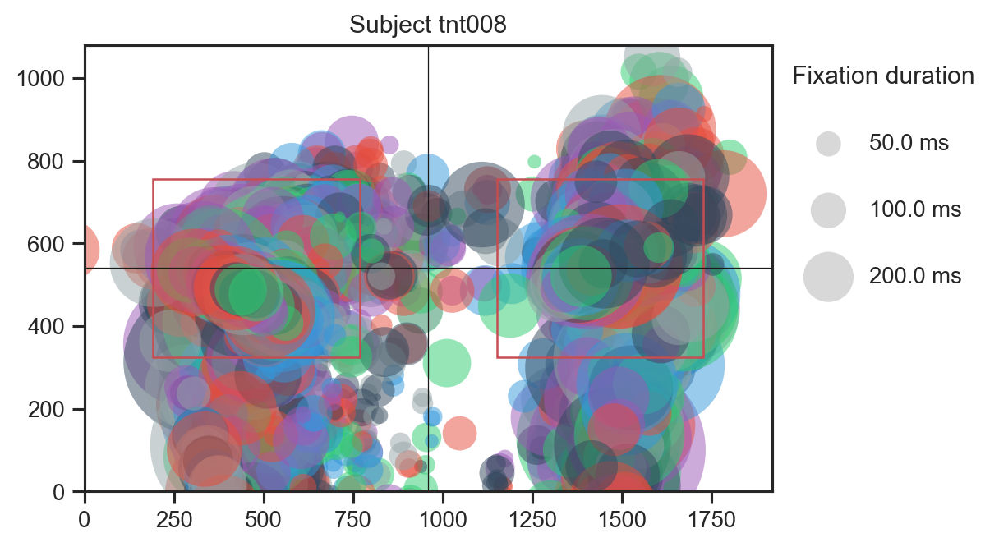

Plotting fixations now...


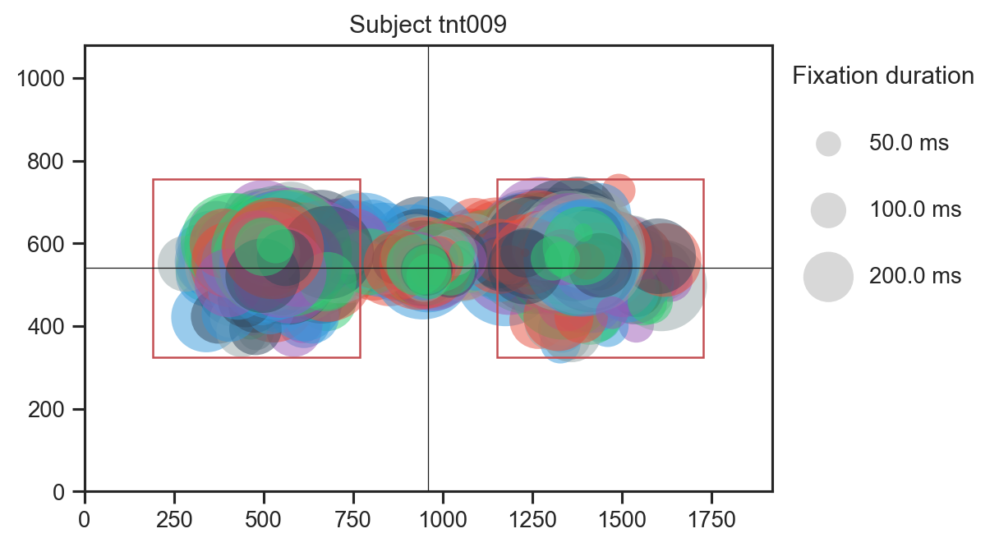

Plotting fixations now...


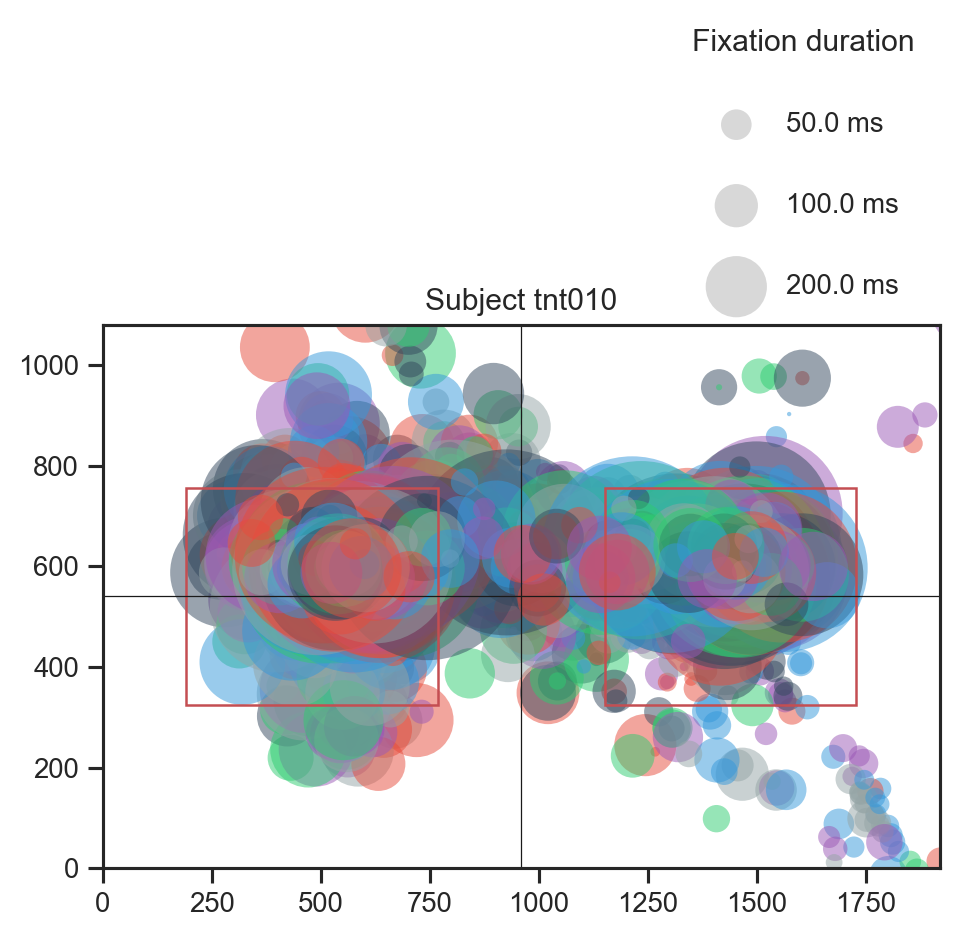

Plotting fixations now...


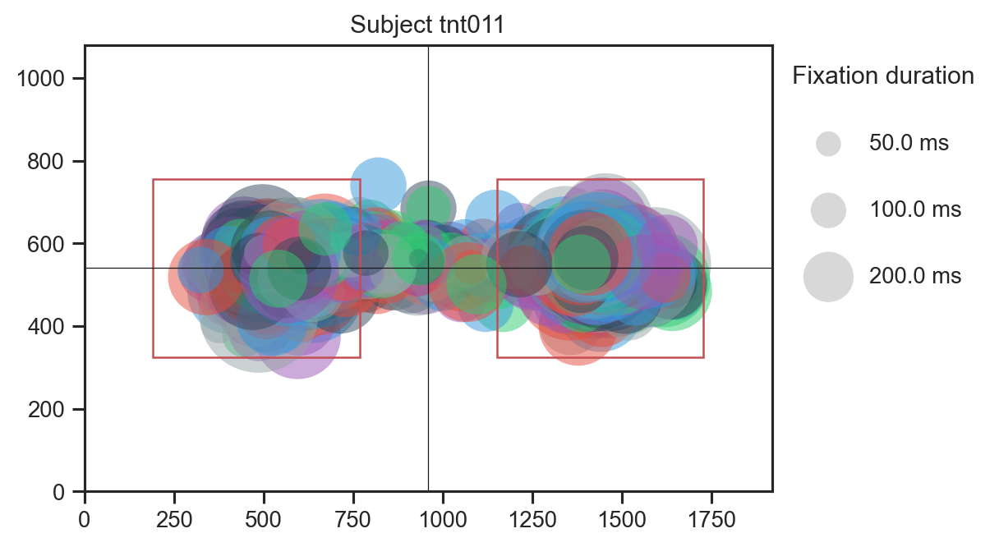

Plotting fixations now...


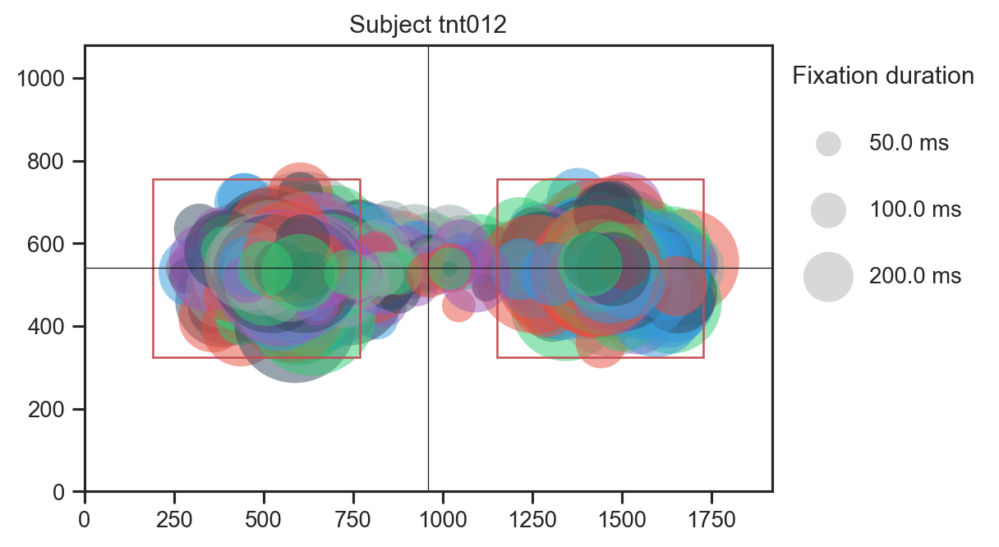

Plotting fixations now...


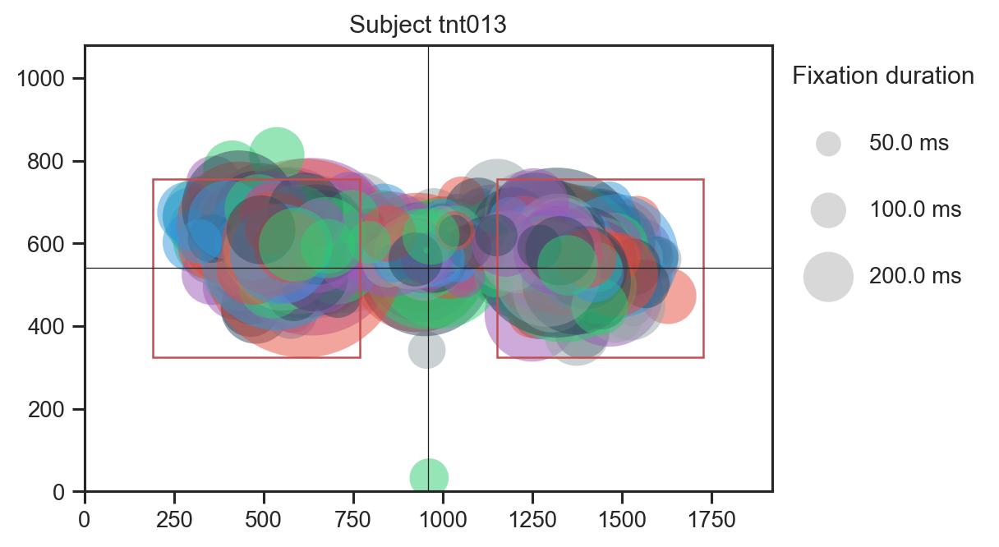

Plotting fixations now...


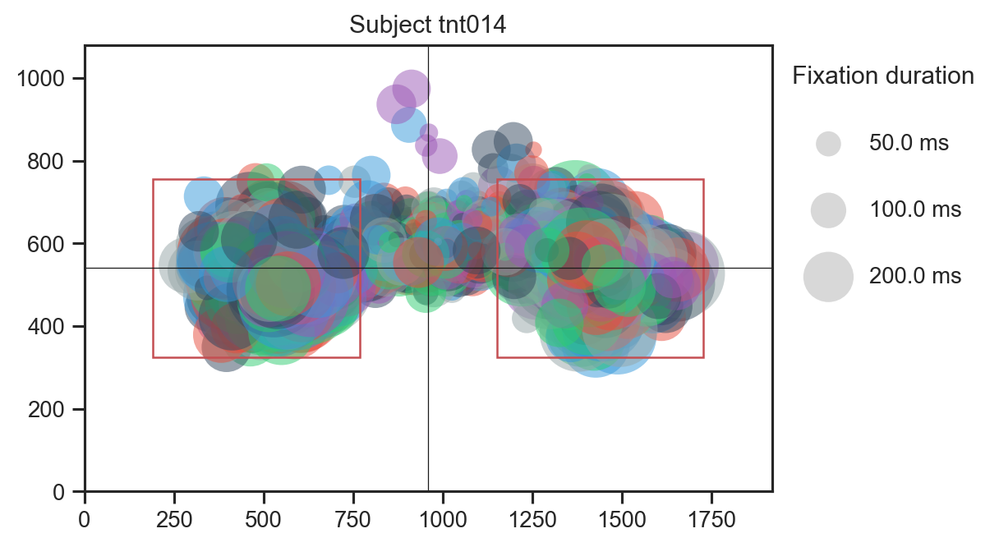

Plotting fixations now...


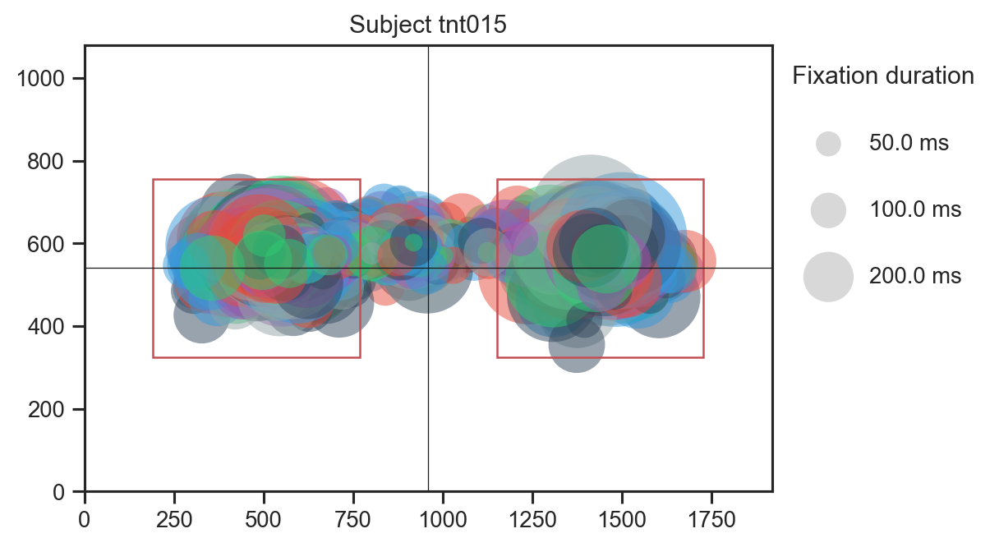

Plotting fixations now...


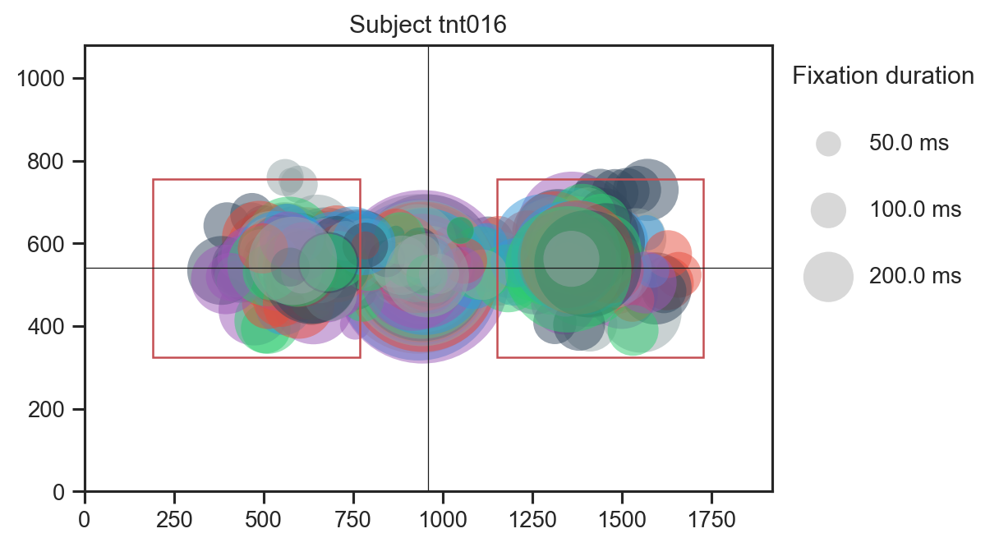

Plotting fixations now...


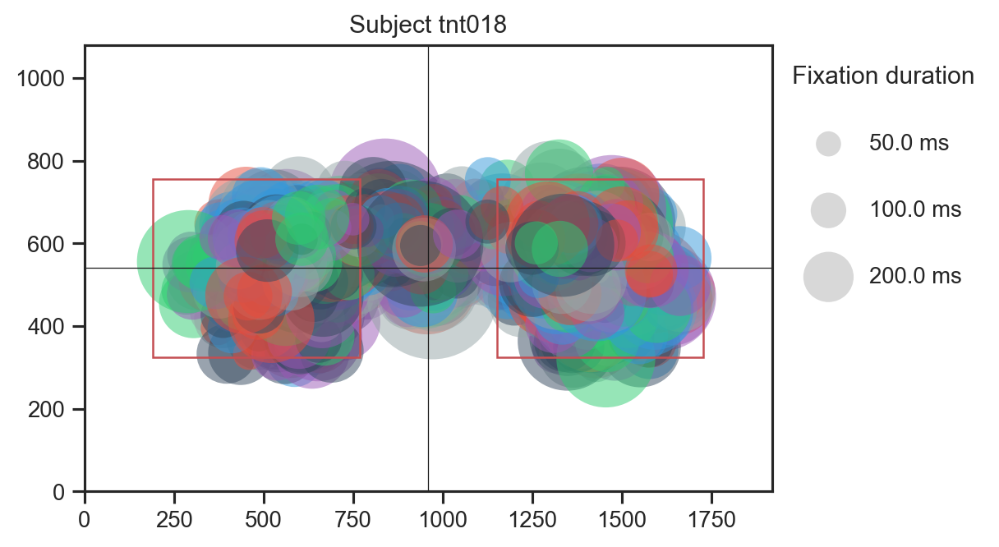

Plotting fixations now...


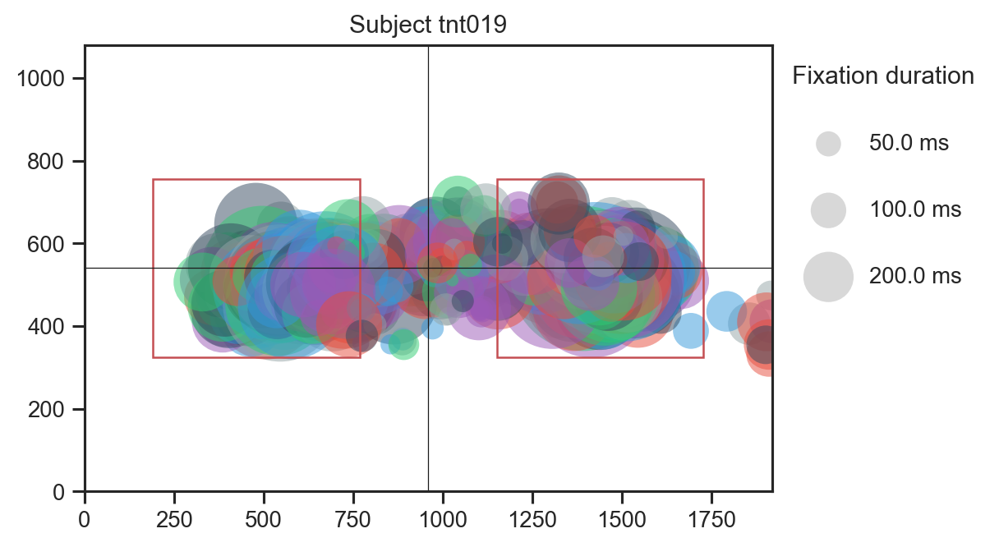

Plotting fixations now...


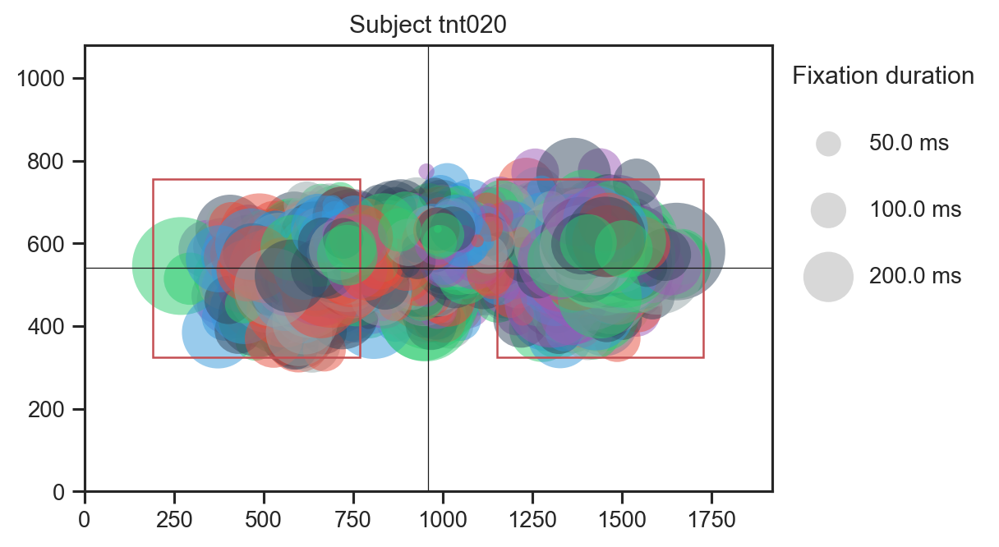

Plotting fixations now...


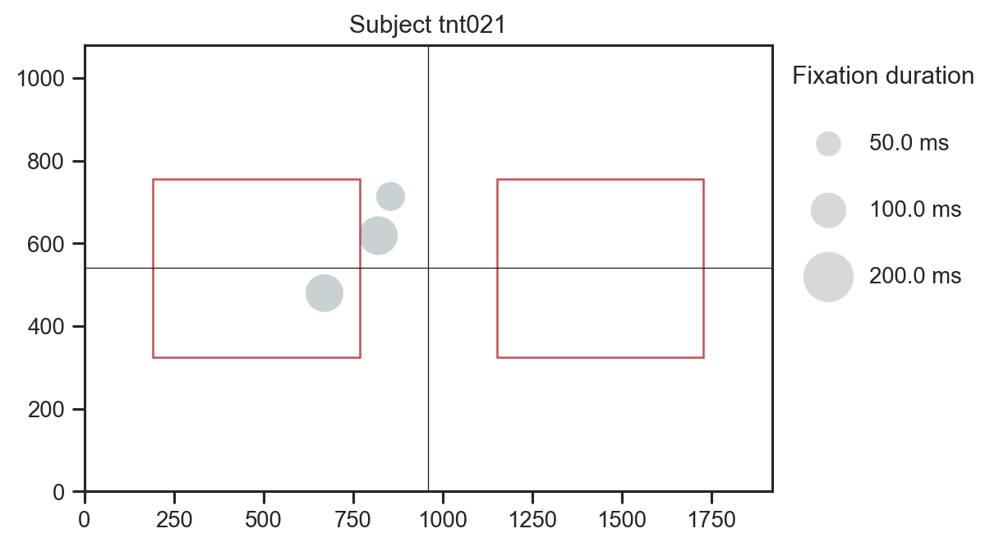

Plotting fixations now...


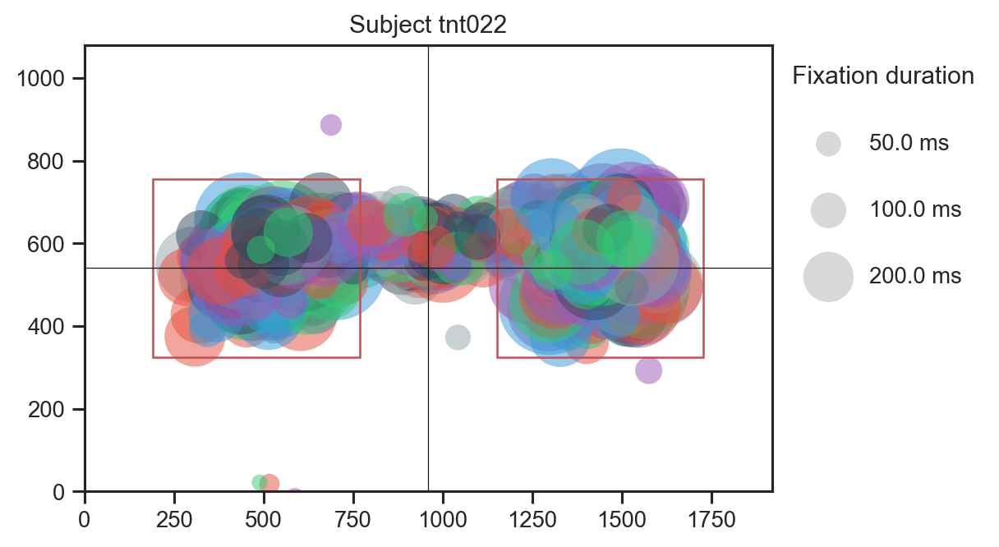

Plotting fixations now...


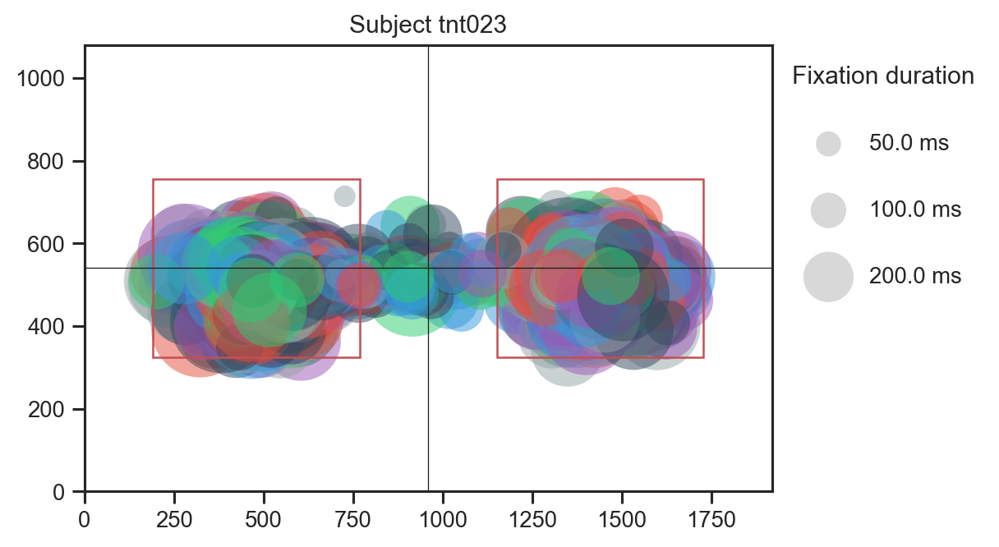

Plotting fixations now...


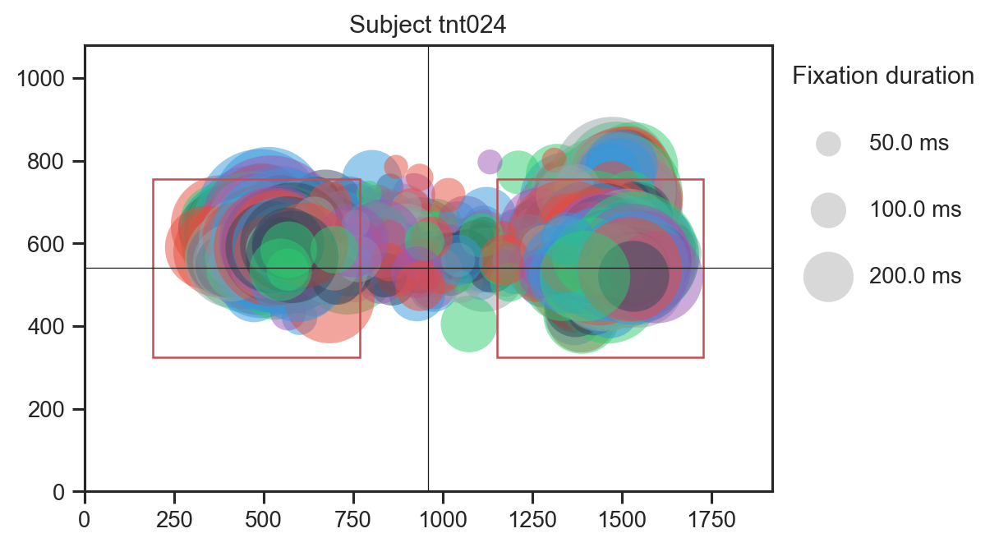

Plotting fixations now...


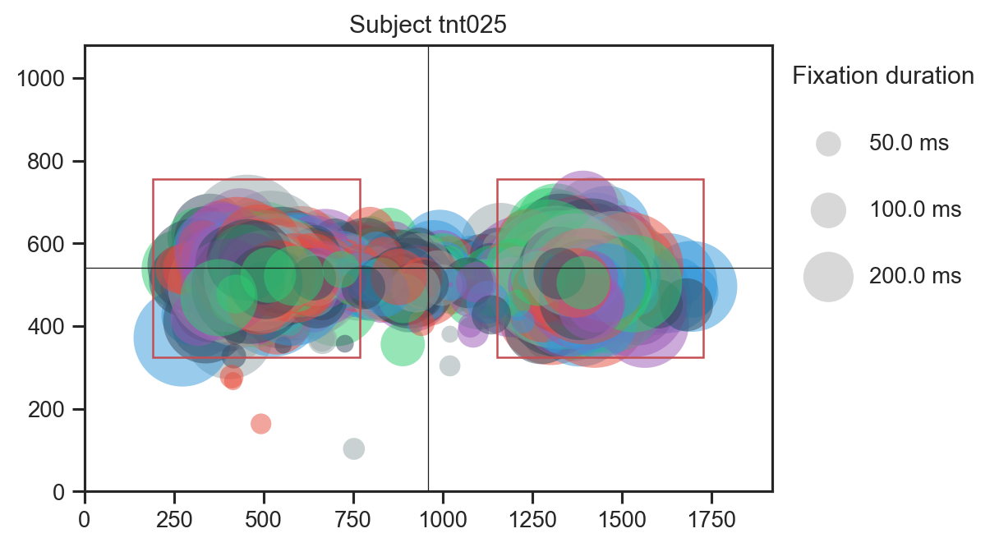

Plotting fixations now...


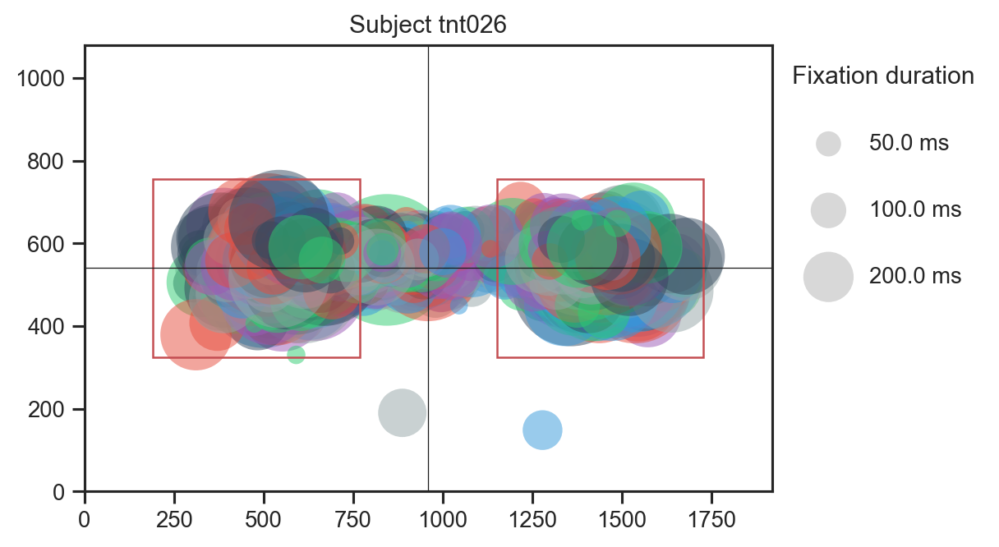

Plotting fixations now...


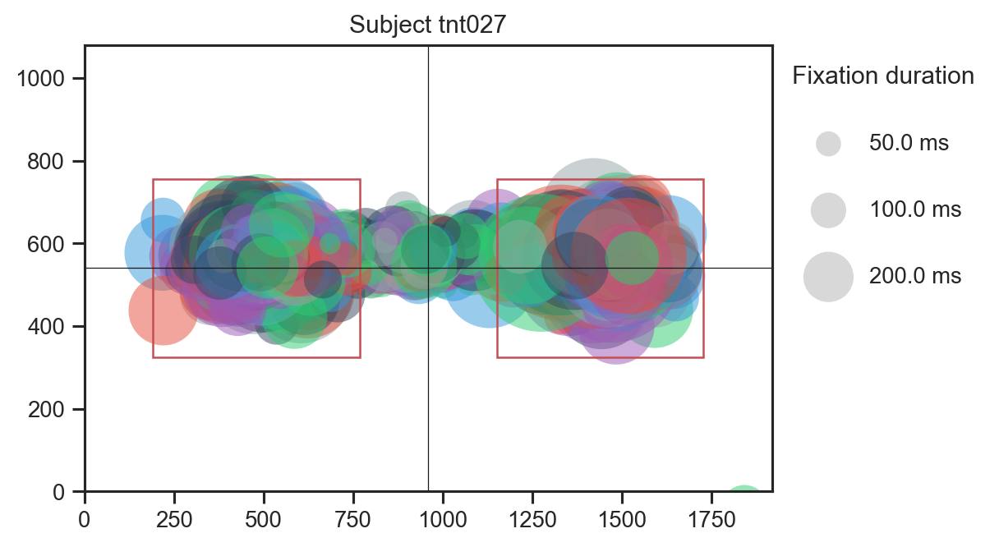

Plotting fixations now...


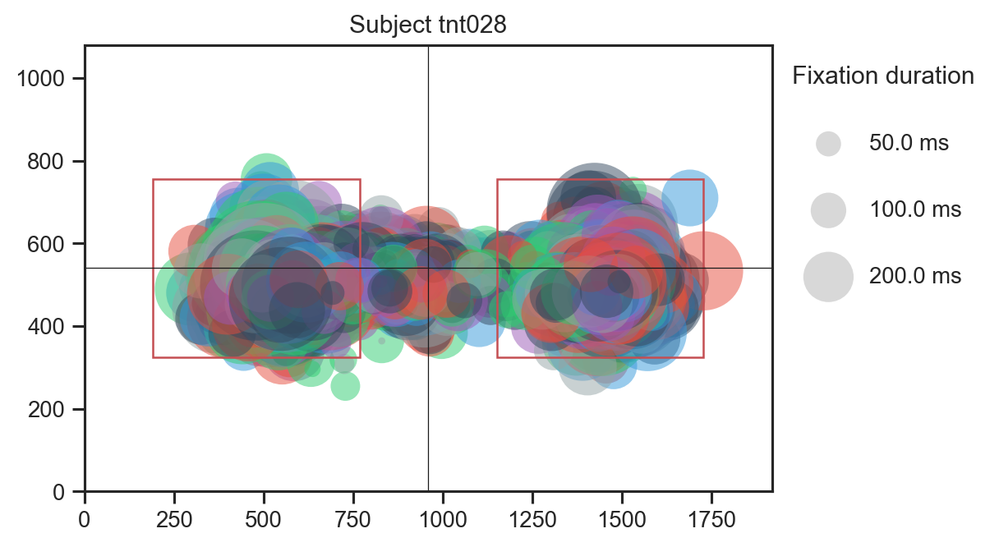

Plotting fixations now...


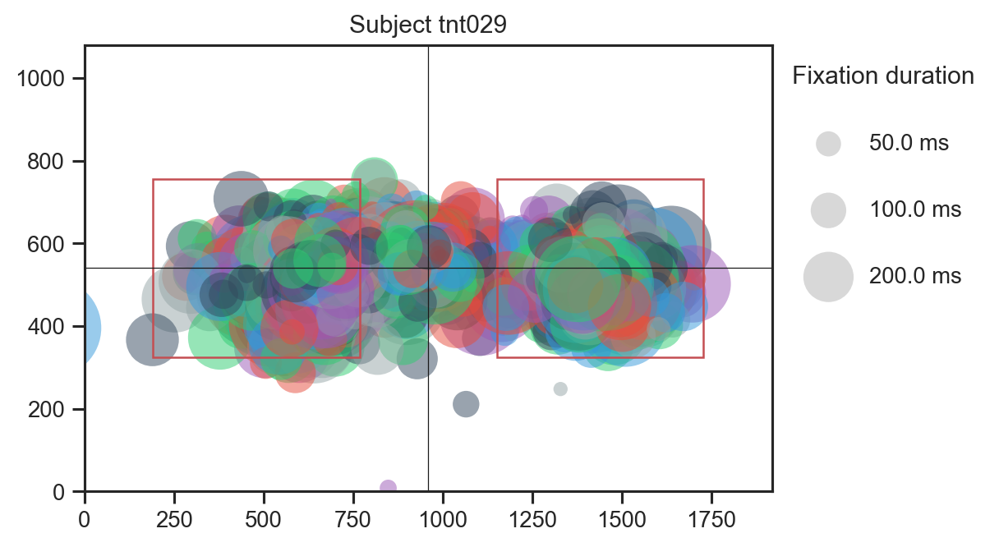

Plotting fixations now...


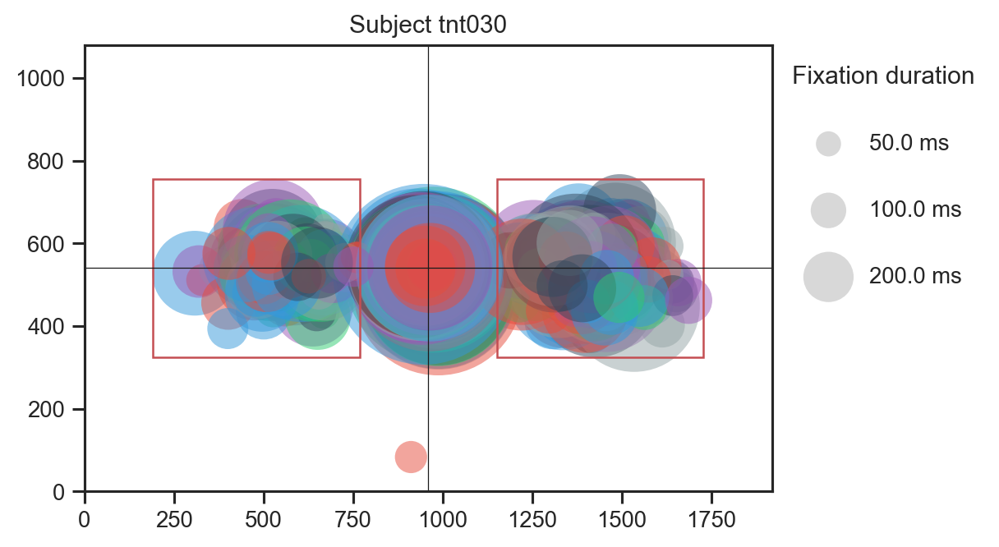

Plotting fixations now...


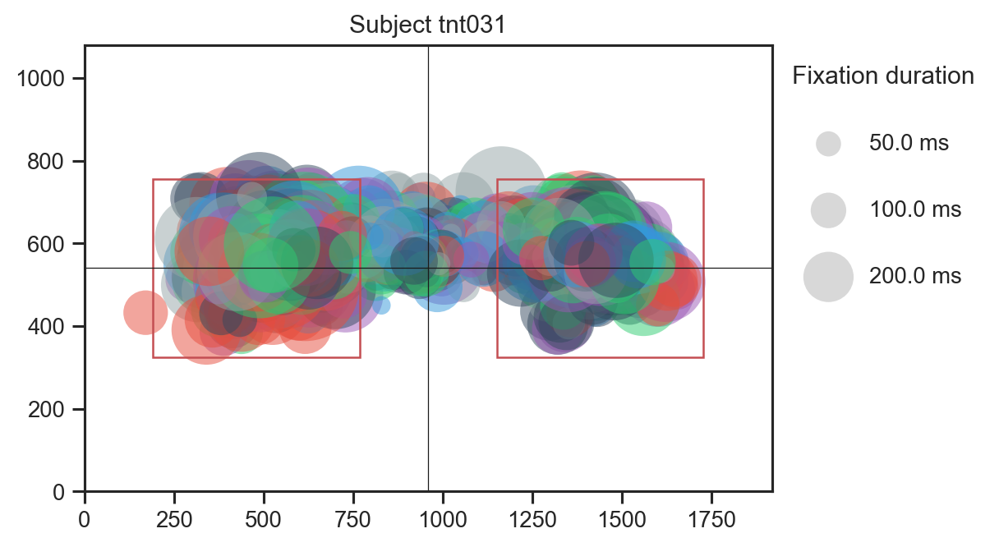

Plotting fixations now...


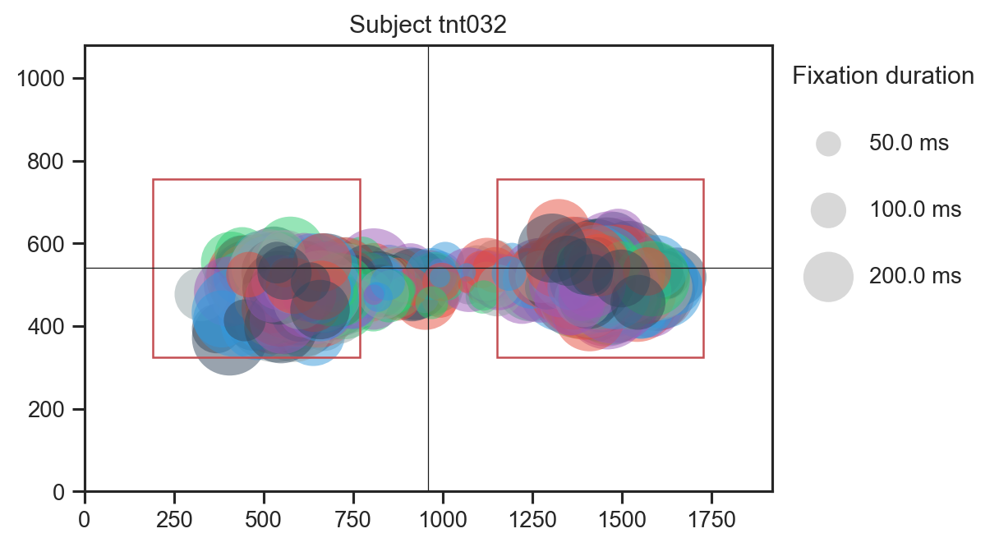

Plotting fixations now...


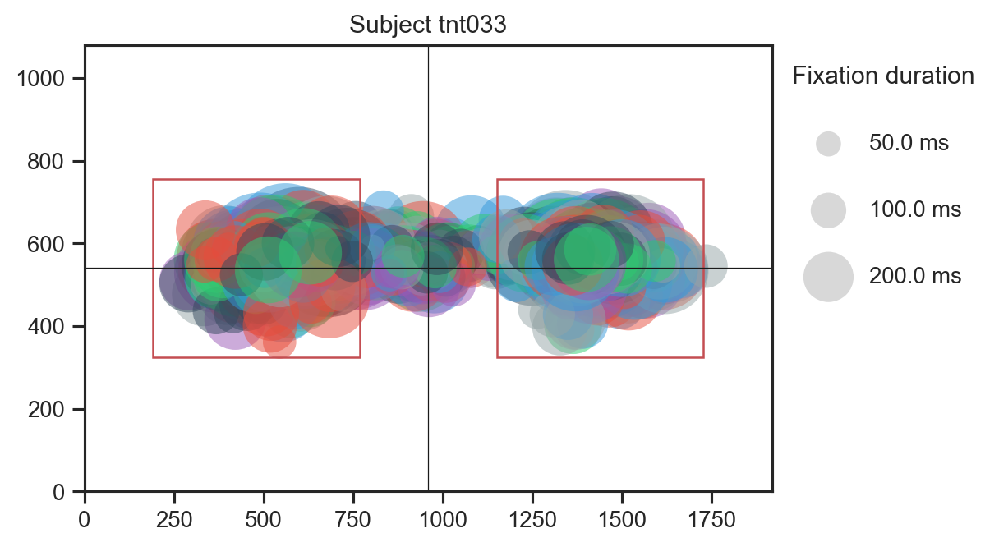

Plotting fixations now...


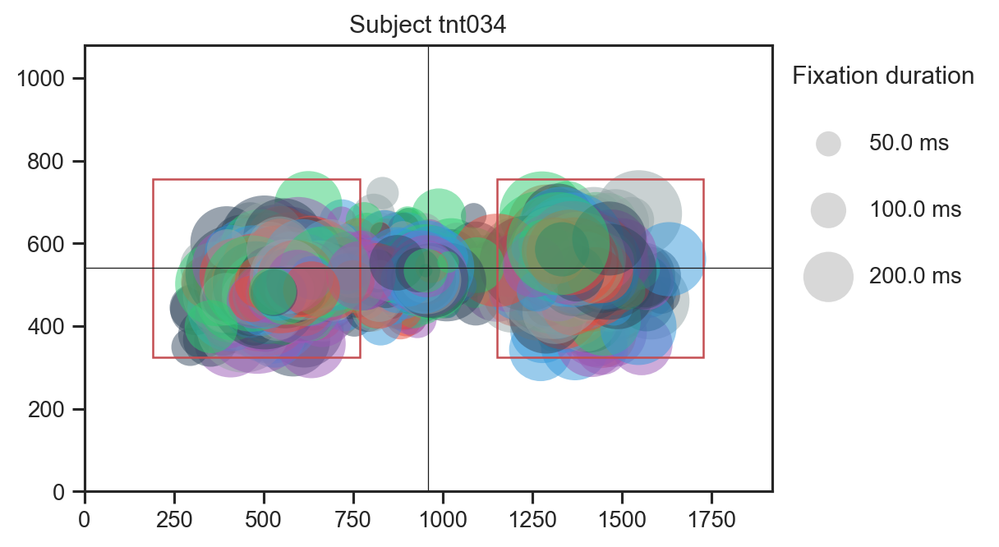

In [12]:
for subjid in subjids:
    eyedata = allEyeData[subjid]
    edfprocessor.plot_all_fixations('Subject ' + subjid,eyedata)

In [13]:
df = df.loc[df['subjid']!='tnt021'] # subject is missing fixation data

## Summary statistics: first fixation

In [14]:
indices_trials_on_stim = df.loc[(df['fix on left_food_stimulus']==True) | (df['fix on right_food_stimulus']==True)][['subjid','trialN','index','fix on left_food_stimulus','fix on right_food_stimulus']].copy()
# indices point to first fixation on L/R stimulus

In [15]:
indices_trials_on_stim.head()

,subjid,trialN,index,fix on left_food_stimulus,fix on right_food_stimulus
2,tnt001,0.0,2,True,False
3,tnt001,0.0,3,True,False
4,tnt001,0.0,4,False,True
5,tnt001,0.0,5,True,False
6,tnt001,0.0,6,True,False


In [16]:
indices_trials_on_stim = indices_trials_on_stim.groupby(['subjid','trialN'],as_index=False).min() # get first fixation that is on a stimulus (L/R) for each trial

In [17]:
# fix on left_food_stimulus now meaningless because False is min of T/F

In [18]:
indices_trials_on_stim = indices_trials_on_stim[['subjid','trialN','index']]

In [19]:
indices_trials_on_stim.head() # fix on left_food_stimulus now meaningless because False is min of T/F

,subjid,trialN,index
0,tnt001,0.0,2
1,tnt001,1.0,8
2,tnt001,2.0,12
3,tnt001,3.0,17
4,tnt001,4.0,22


In [20]:
df_first_fix = pd.merge(indices_trials_on_stim,df,on=['subjid','trialN','index'])

In [21]:
df_first_fix['first_fix_on_chosen'] = (df_first_fix['fix on left_food_stimulus'] == True) & (df_first_fix['choseright'] == False) | (df_first_fix['fix on right_food_stimulus'] == True) & (df_first_fix['choseright'] == True)

In [22]:
df_first_fix.head()

,subjid,trialN,index,Unnamed: 0_x,avg x pos,avg y pos,duration,fix on left_food_stimulus,fix on right_food_stimulus,type,...,choiceCondition,rightStimCondition,leftStimCondition,rightStimRating_z,leftStimRating_z,deltaval,deltaval_z,absdeltaval_z,condition,first_fix_on_chosen
0,tnt001,0.0,2,2,429.9,510.9,223.0,True,False,started and ended during trial,...,nothink_v_nothink,nothink,nothink,-1.030281,0.909705,-6.72,-1.94,1.94,-1,True
1,tnt001,1.0,8,8,421.1,528.6,225.0,True,False,started and ended during trial,...,baseline_v_baseline,baseline,baseline,0.866402,-1.269892,7.40,2.14,2.14,0,False
2,tnt001,2.0,12,12,573.4,510.8,158.0,True,False,started before trial,...,nothink_v_nothink,nothink,nothink,0.317894,1.227263,-3.15,-0.91,0.91,-1,True
3,tnt001,3.0,17,17,719.4,516.6,151.0,True,False,started before trial,...,baseline_v_baseline,baseline,baseline,1.611218,-0.963883,8.92,2.58,2.58,0,False
4,tnt001,4.0,22,22,566.7,511.6,9.0,True,False,started before trial,...,think_v_think,think,think,1.310982,0.886610,1.47,0.42,0.42,1,False


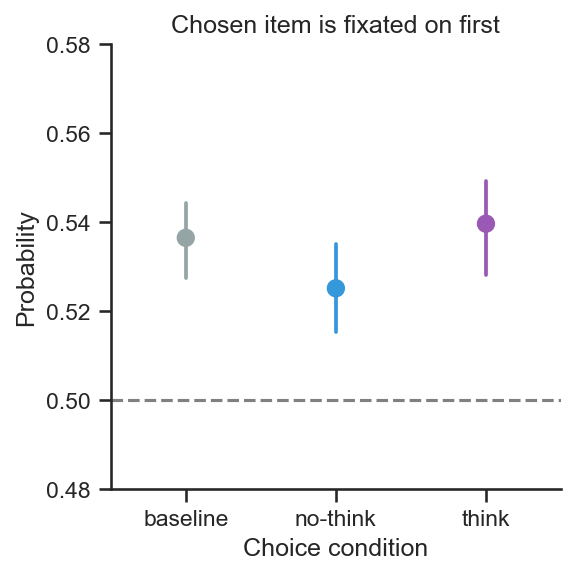

In [23]:
m_df_first_fix = df_first_fix.groupby(['subjid','choiceCondition'],as_index=False).mean()
order = ['baseline','no-think','think']
m_df_first_fix.replace({'baseline_v_baseline':'baseline','think_v_think':'think','nothink_v_nothink':'no-think'},inplace=True)
plt.figure(dpi=150,figsize=(4,4))
plt.axhline(.50,color='grey',ls='--')
sns.pointplot(x='choiceCondition',y='first_fix_on_chosen',errwidth=1.8,join=False,ci=68,data=m_df_first_fix,order=order,palette=colors)
plt.title('Chosen item is fixated on first')
plt.ylabel('Probability')
plt.xlabel('Choice condition')
plt.ylim([.48,.58])
sns.despine()
plt.tight_layout()
plt.show()

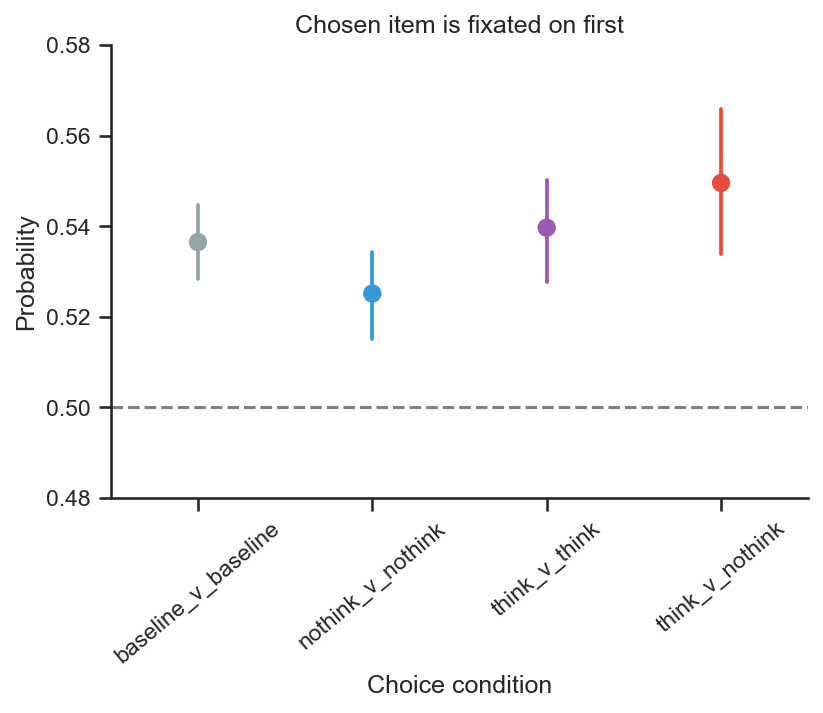

In [24]:
m_df_first_fix = df_first_fix.groupby(['subjid','choiceCondition'],as_index=False).mean()
order = ['baseline_v_baseline','nothink_v_nothink','think_v_think','think_v_nothink']
plt.figure(dpi=150)
plt.axhline(.50,color='grey',ls='--')
sns.pointplot(x='choiceCondition',y='first_fix_on_chosen',errwidth=1.8,join=False,ci=68,data=m_df_first_fix,order=order,palette=colors)
plt.title('Chosen item is fixated on first')
plt.ylabel('Probability')
plt.xlabel('Choice condition')
plt.xticks(rotation=40)
plt.ylim([.48,.58])
sns.despine()
plt.show()

In [25]:
tnt_df_first_fix = df_first_fix.loc[(df_first_fix['choiceCondition'] == 'think_v_nothink')].copy()
tnt_df_first_fix['first_fix_on_think'] = (tnt_df_first_fix['fix on left_food_stimulus'] == True) & (tnt_df_first_fix['leftStimCondition'] == 'think') | (tnt_df_first_fix['fix on right_food_stimulus'] == True) & (tnt_df_first_fix['rightStimCondition'] == 'think')

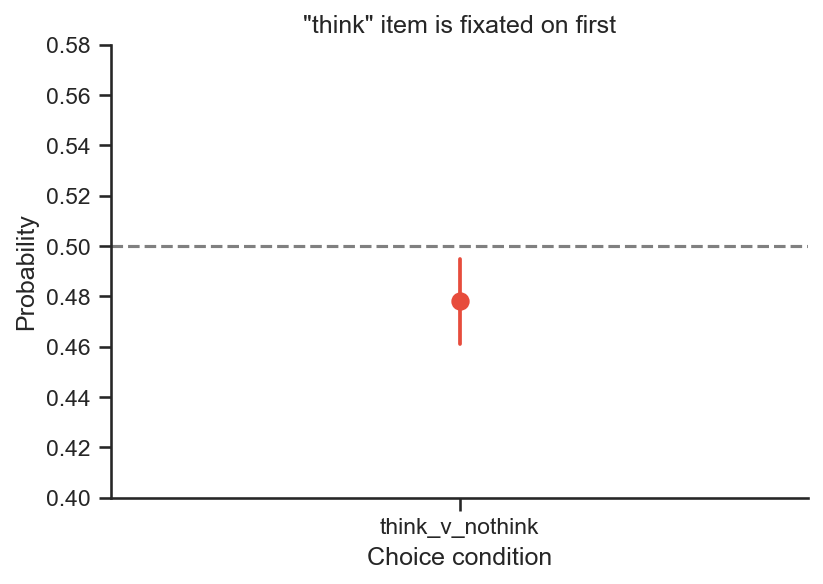

In [26]:
m_tnt_df_first_fix = tnt_df_first_fix.groupby(['subjid','choiceCondition'],as_index=False).mean()
order = ['think_v_nothink']
plt.figure(dpi=150)
plt.axhline(.50,color='grey',ls='--')
sns.pointplot(x='choiceCondition',y='first_fix_on_think',join=False,ci=68,errwidth=1.8,data=m_tnt_df_first_fix,order=order,color=colors[3])
plt.title('"think" item is fixated on first')
plt.ylabel('Probability')
plt.xlabel('Choice condition')
plt.ylim([.4,.58])
sns.despine()
plt.show()

## Summary statistics: last fixation

In [27]:
indices_trials_on_stim = df.loc[(df['fix on left_food_stimulus']==True) | (df['fix on right_food_stimulus']==True)][['subjid','trialN','index','fix on left_food_stimulus','fix on right_food_stimulus']].copy() 
# indices point to first fixation on L/R stimulus

In [28]:
indices_trials_on_stim.head()

,subjid,trialN,index,fix on left_food_stimulus,fix on right_food_stimulus
2,tnt001,0.0,2,True,False
3,tnt001,0.0,3,True,False
4,tnt001,0.0,4,False,True
5,tnt001,0.0,5,True,False
6,tnt001,0.0,6,True,False


In [29]:
indices_trials_on_stim = indices_trials_on_stim.groupby(['subjid','trialN'],as_index=False).max() # get last fixation that is on a stimulus (L/R) for each trial

In [30]:
# fix on left_food_stimulus now meaningless because True is max of T/F

In [31]:
indices_trials_on_stim = indices_trials_on_stim[['subjid','trialN','index']]

In [32]:
indices_trials_on_stim.head() # fix on left_food_stimulus now meaningless because True is max of T/F

,subjid,trialN,index
0,tnt001,0.0,6
1,tnt001,1.0,11
2,tnt001,2.0,16
3,tnt001,3.0,21
4,tnt001,4.0,28


In [33]:
df_last_fix = pd.merge(indices_trials_on_stim,df,on=['subjid','trialN','index'])

In [34]:
df_last_fix['last_fix_on_chosen'] = (df_last_fix['fix on left_food_stimulus'] == True) & (df_last_fix['choseright'] == False) | (df_last_fix['fix on right_food_stimulus'] == True) & (df_last_fix['choseright'] == True)

In [35]:
df_last_fix.head()

,subjid,trialN,index,Unnamed: 0_x,avg x pos,avg y pos,duration,fix on left_food_stimulus,fix on right_food_stimulus,type,...,choiceCondition,rightStimCondition,leftStimCondition,rightStimRating_z,leftStimRating_z,deltaval,deltaval_z,absdeltaval_z,condition,last_fix_on_chosen
0,tnt001,0.0,6,6,537.5,483.9,97.0,True,False,ended after trial,...,nothink_v_nothink,nothink,nothink,-1.030281,0.909705,-6.72,-1.94,1.94,-1,True
1,tnt001,1.0,11,11,1341.5,615.9,217.0,False,True,ended after trial,...,baseline_v_baseline,baseline,baseline,0.866402,-1.269892,7.40,2.14,2.14,0,True
2,tnt001,2.0,16,16,451.5,575.5,125.0,True,False,ended after trial,...,nothink_v_nothink,nothink,nothink,0.317894,1.227263,-3.15,-0.91,0.91,-1,True
3,tnt001,3.0,21,21,436.2,569.8,9.0,True,False,ended after trial,...,baseline_v_baseline,baseline,baseline,1.611218,-0.963883,8.92,2.58,2.58,0,False
4,tnt001,4.0,28,28,1395.4,560.6,52.0,False,True,ended after trial,...,think_v_think,think,think,1.310982,0.886610,1.47,0.42,0.42,1,True


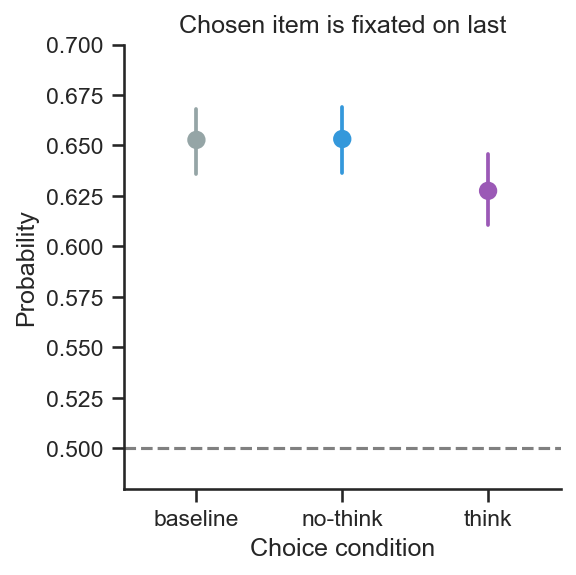

In [36]:
m_df_last_fix = df_last_fix.groupby(['subjid','choiceCondition'],as_index=False).mean()
order = ['baseline','no-think','think']
m_df_last_fix.replace({'baseline_v_baseline':'baseline','think_v_think':'think','nothink_v_nothink':'no-think'},inplace=True)
plt.figure(dpi=150,figsize=(4,4))
plt.axhline(.50,color='grey',ls='--')
sns.pointplot(x='choiceCondition',y='last_fix_on_chosen',join=False,ci=68,errwidth=1.8,data=m_df_last_fix,order=order,palette=colors)
plt.title('Chosen item is fixated on last')
plt.ylabel('Probability')
plt.xlabel('Choice condition')
plt.ylim([.48,.7])
sns.despine()
plt.tight_layout()
plt.show()

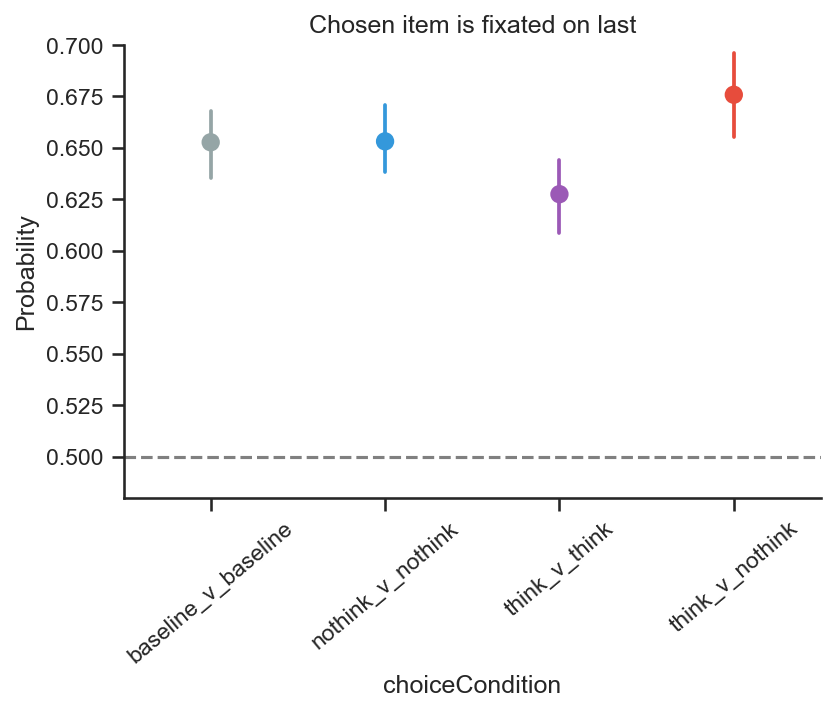

In [37]:
m_df_last_fix = df_last_fix.groupby(['subjid','choiceCondition'],as_index=False).mean()
order = ['baseline_v_baseline','nothink_v_nothink','think_v_think','think_v_nothink']
plt.figure(dpi=150)
plt.axhline(.50,color='grey',ls='--')
sns.pointplot(x='choiceCondition',y='last_fix_on_chosen',join=False,errwidth=1.8,ci=68,data=m_df_last_fix,order=order,palette=colors)
plt.title('Chosen item is fixated on last')
plt.ylabel('Probability')
plt.xticks(rotation=40)
plt.ylim([.48,.7])
sns.despine()
plt.show()

In [38]:
tnt_df_last_fix = df_last_fix.loc[(df_last_fix['choiceCondition'] == 'think_v_nothink')].copy()
tnt_df_last_fix['last_fix_on_think'] = (tnt_df_last_fix['fix on left_food_stimulus'] == True) & (tnt_df_last_fix['leftStimCondition'] == 'think') | (tnt_df_last_fix['fix on right_food_stimulus'] == True) & (tnt_df_last_fix['rightStimCondition'] == 'think')

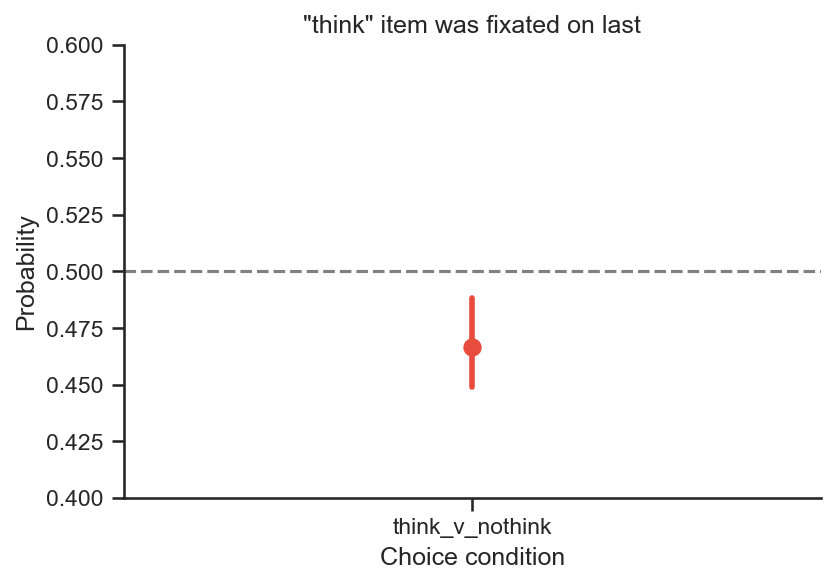

In [39]:
m_tnt_df_last_fix = tnt_df_last_fix.groupby(['subjid','choiceCondition'],as_index=False).mean()
order = ['think_v_nothink']
plt.figure(dpi=150)
plt.axhline(.50,color='grey',ls='--')
sns.pointplot(x='choiceCondition',y='last_fix_on_think',join=False,ci=68,data=m_tnt_df_last_fix,order=order,color=colors[3])
plt.title('"think" item was fixated on last')
plt.ylabel('Probability')
plt.xlabel('Choice condition')
plt.ylim([.4,.6])
sns.despine()
plt.show()

## Differences in number and duration of fixations on chosen and unchosen item

In [40]:
df_fix_on_stim = df.loc[(df['fix on left_food_stimulus']==True) | (df['fix on right_food_stimulus']==True)].copy()
df_fix_on_stim['fix_on_chosen'] = ((df['fix on right_food_stimulus'] == True) & (df['choseright'] == True)) | ((df['fix on left_food_stimulus'] == True) & (df['choseright'] == False))

In [41]:
df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','trialN','fix_on_chosen'],as_index=False).sum() # sum of duration within trials
df_fix_on_stim['duration/RT'] = df_fix_on_stim['duration']/df_fix_on_stim['rt']/1000

In [42]:
df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','fix_on_chosen'],as_index=False).mean() # avg across trials

In [43]:
df_fix_on_stim.columns

Index(['subjid', 'choiceCondition', 'fix_on_chosen', 'trialN', 'Unnamed: 0_x',
       'avg x pos', 'avg y pos', 'duration', 'fix on left_food_stimulus',
       'fix on right_food_stimulus', 'index', 'Unnamed: 0_y', 'leftStimRating',
       'rightStimRating', 'choseright', 'rt', 'rightStimRating_z',
       'leftStimRating_z', 'deltaval', 'deltaval_z', 'absdeltaval_z',
       'condition', 'duration/RT'],
      dtype='object')

In [44]:
df_fix_on_stim.head()

,subjid,choiceCondition,fix_on_chosen,trialN,Unnamed: 0_x,avg x pos,avg y pos,duration,fix on left_food_stimulus,fix on right_food_stimulus,...,rightStimRating,choseright,rt,rightStimRating_z,leftStimRating_z,deltaval,deltaval_z,absdeltaval_z,condition,duration/RT
0,tnt001,baseline_v_baseline,False,194.336134,1978.890756,1816.077311,1076.855462,434.159664,1.294118,0.823529,...,11.324958,1.294118,2.923422,0.580201,-0.351705,3.228067,0.932941,2.514958,0.000000,0.229199
1,tnt001,baseline_v_baseline,True,194.336134,2211.831933,2093.649580,1226.580672,493.848739,1.453782,0.949580,...,10.303866,0.949580,3.348962,-0.077403,0.090982,-0.583277,-0.167899,2.641849,0.000000,0.225154
2,tnt001,nothink_v_nothink,False,206.168067,2187.521008,1893.873109,1085.863866,410.184874,1.260504,0.848739,...,8.664454,1.260504,2.922046,-0.177185,-0.459784,0.978908,0.282689,2.376639,-2.109244,0.212278
3,tnt001,nothink_v_nothink,True,206.168067,2415.159664,2133.492437,1202.408403,487.899160,1.336134,0.991597,...,8.227983,0.991597,3.091728,-0.580644,-0.084318,-1.719244,-0.496303,2.662353,-2.327731,0.218555
4,tnt001,think_v_nothink,False,203.485714,2281.085714,2157.594286,1208.677143,483.828571,1.285714,1.085714,...,8.653429,1.285714,4.322086,-0.513314,-0.132328,-1.319714,-0.380000,1.420571,4.742857,0.196753


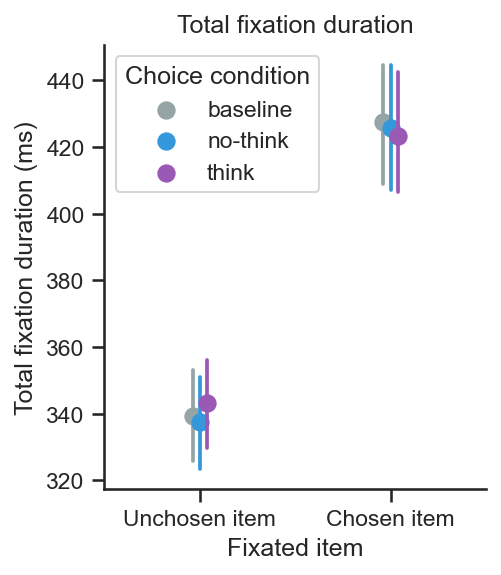

In [45]:
m_df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','fix_on_chosen'],as_index=False).mean()
order = ['baseline','no-think','think']
m_df_fix_on_stim.replace({'baseline_v_baseline':'baseline','think_v_think':'think','nothink_v_nothink':'no-think'},inplace=True)
m_df_fix_on_stim.replace({True:'Chosen item',False:'Unchosen item'},inplace=True)
plt.figure(dpi=150,figsize=(3.5,4))
ax = sns.pointplot(x='fix_on_chosen',y='duration',hue='choiceCondition',dodge=True,join=False,errwidth=1.8,ci=68,data=m_df_fix_on_stim,hue_order=order,legend_out=True)
plt.ylabel('Total fixation duration (ms)')
plt.xlabel('Fixated item')
plt.title('Total fixation duration')
leg_handles = ax.get_legend_handles_labels()[0]
ax.legend(leg_handles, order, title='Choice condition')
sns.despine()
plt.tight_layout()
plt.show()

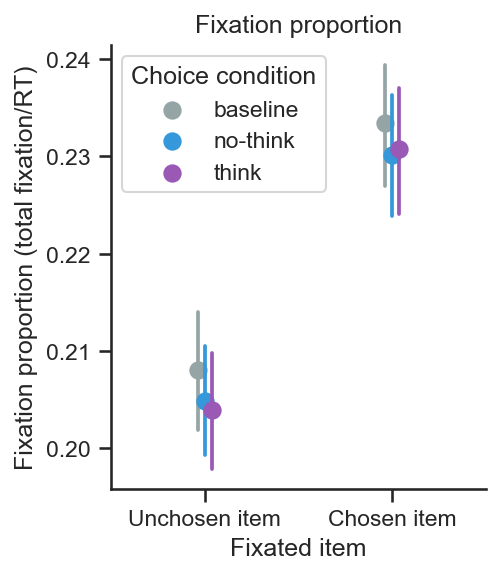

In [46]:
m_df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','fix_on_chosen'],as_index=False).mean()
order = ['baseline','no-think','think']
m_df_fix_on_stim.replace({'baseline_v_baseline':'baseline','think_v_think':'think','nothink_v_nothink':'no-think'},inplace=True)
m_df_fix_on_stim.replace({True:'Chosen item',False:'Unchosen item'},inplace=True)
plt.figure(dpi=150,figsize=(3.5,4))
ax = sns.pointplot(x='fix_on_chosen',y='duration/RT',hue='choiceCondition',dodge=True,join=False,errwidth=1.8,ci=68,data=m_df_fix_on_stim,hue_order=order)
plt.ylabel('Fixation proportion (total fixation/RT)')
plt.xlabel('Fixated item')
plt.title('Fixation proportion')
leg_handles = ax.get_legend_handles_labels()[0]
ax.legend(leg_handles, order, title='Choice condition')
sns.despine()
plt.tight_layout()
plt.show()

### Difference in number of fixations

In [47]:
df_fix_on_stim = df.loc[(df['fix on left_food_stimulus']==True) | (df['fix on right_food_stimulus']==True)].copy()
df_fix_on_stim['fix_on_chosen'] = ((df['fix on right_food_stimulus'] == True) & (df['choseright'] == True)) | ((df['fix on left_food_stimulus'] == True) & (df['choseright'] == False))

In [48]:
df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','trialN','fix_on_chosen'],as_index=False).count() # avg within trials

In [49]:
df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','fix_on_chosen'],as_index=False).mean() # avg across trials

In [50]:
df_fix_on_stim.columns

Index(['subjid', 'choiceCondition', 'fix_on_chosen', 'trialN', 'Unnamed: 0_x',
       'avg x pos', 'avg y pos', 'duration', 'fix on left_food_stimulus',
       'fix on right_food_stimulus', 'index', 'type', 'Unnamed: 0_y',
       'leftStim', 'leftStimRating', 'rightStim', 'rightStimRating',
       'choseright', 'rt', 'rightStimCondition', 'leftStimCondition',
       'rightStimRating_z', 'leftStimRating_z', 'deltaval', 'deltaval_z',
       'absdeltaval_z', 'condition'],
      dtype='object')

In [51]:
df_fix_on_stim.head()

,subjid,choiceCondition,fix_on_chosen,trialN,Unnamed: 0_x,avg x pos,avg y pos,duration,fix on left_food_stimulus,fix on right_food_stimulus,...,choseright,rt,rightStimCondition,leftStimCondition,rightStimRating_z,leftStimRating_z,deltaval,deltaval_z,absdeltaval_z,condition
0,tnt001,baseline_v_baseline,False,194.336134,2.117647,2.117647,2.117647,2.117647,2.117647,2.117647,...,2.117647,2.117647,2.117647,2.117647,2.117647,2.117647,2.117647,2.117647,2.117647,2.117647
1,tnt001,baseline_v_baseline,True,194.336134,2.403361,2.403361,2.403361,2.403361,2.403361,2.403361,...,2.403361,2.403361,2.403361,2.403361,2.403361,2.403361,2.403361,2.403361,2.403361,2.403361
2,tnt001,nothink_v_nothink,False,206.168067,2.109244,2.109244,2.109244,2.109244,2.109244,2.109244,...,2.109244,2.109244,2.109244,2.109244,2.109244,2.109244,2.109244,2.109244,2.109244,2.109244
3,tnt001,nothink_v_nothink,True,206.168067,2.327731,2.327731,2.327731,2.327731,2.327731,2.327731,...,2.327731,2.327731,2.327731,2.327731,2.327731,2.327731,2.327731,2.327731,2.327731,2.327731
4,tnt001,think_v_nothink,False,203.485714,2.371429,2.371429,2.371429,2.371429,2.371429,2.371429,...,2.371429,2.371429,2.371429,2.371429,2.371429,2.371429,2.371429,2.371429,2.371429,2.371429


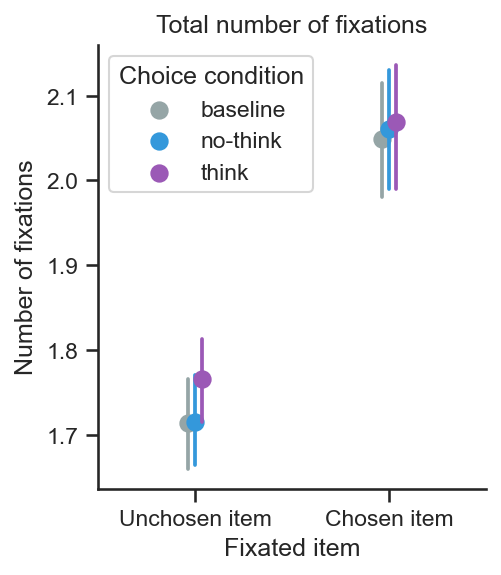

In [52]:
m_df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','fix_on_chosen'],as_index=False).mean()
order = ['baseline','no-think','think']
m_df_fix_on_stim.replace({'baseline_v_baseline':'baseline','think_v_think':'think','nothink_v_nothink':'no-think'},inplace=True)
m_df_fix_on_stim.replace({True:'Chosen item',False:'Unchosen item'},inplace=True)
plt.figure(dpi=150,figsize=(3.5,4))
ax = sns.pointplot(x='fix_on_chosen',y='duration',hue='choiceCondition',dodge=True,join=False,errwidth=1.8,ci=68,data=m_df_fix_on_stim,hue_order=order)
plt.ylabel('Number of fixations')
plt.xlabel('Fixated item')
leg_handles = ax.get_legend_handles_labels()[0]
ax.legend(leg_handles, order, title='Choice condition')
plt.title('Total number of fixations')
sns.despine()
plt.tight_layout()
plt.show()

## Differences in fixations on left and right stimuli

In [53]:
df_fix_on_stim = df.loc[(df['fix on left_food_stimulus']==True) | (df['fix on right_food_stimulus']==True)]

In [54]:
df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','trialN','fix on left_food_stimulus','fix on right_food_stimulus'],as_index=False).sum() # sum of duration within trials
df_fix_on_stim['duration/RT'] = df_fix_on_stim['duration']/df_fix_on_stim['rt']/1000

In [55]:
df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','fix on left_food_stimulus','fix on right_food_stimulus'],as_index=False).mean() # avg across trials

In [56]:
df_fix_on_stim.columns

Index(['subjid', 'choiceCondition', 'fix on left_food_stimulus',
       'fix on right_food_stimulus', 'trialN', 'Unnamed: 0_x', 'avg x pos',
       'avg y pos', 'duration', 'index', 'Unnamed: 0_y', 'leftStimRating',
       'rightStimRating', 'choseright', 'rt', 'rightStimRating_z',
       'leftStimRating_z', 'deltaval', 'deltaval_z', 'absdeltaval_z',
       'condition', 'duration/RT'],
      dtype='object')

In [57]:
df_fix_on_stim.head()

,subjid,choiceCondition,fix on left_food_stimulus,fix on right_food_stimulus,trialN,Unnamed: 0_x,avg x pos,avg y pos,duration,index,...,rightStimRating,choseright,rt,rightStimRating_z,leftStimRating_z,deltaval,deltaval_z,absdeltaval_z,condition,duration/RT
0,tnt001,baseline_v_baseline,False,True,194.336134,1613.327731,2512.432773,904.509244,458.352941,1613.327731,...,8.391092,0.949580,2.536021,0.170754,-0.262376,1.500336,0.433782,2.015462,0.000000,0.283231
1,tnt001,baseline_v_baseline,True,False,194.336134,2577.394958,1397.294118,1398.926891,469.655462,2577.394958,...,13.237731,1.294118,3.736363,0.332044,0.001653,1.144454,0.331261,3.141345,0.000000,0.171122
2,tnt001,nothink_v_nothink,False,True,206.168067,1861.882353,2634.548739,955.384874,439.504202,1861.882353,...,7.211597,0.991597,2.592513,-0.255124,-0.273950,0.065210,0.018824,2.060336,-1.840336,0.251676
3,tnt001,nothink_v_nothink,True,False,206.168067,2740.798319,1392.816807,1332.887395,458.579832,2740.798319,...,9.680840,1.260504,3.421261,-0.502705,-0.270153,-0.805546,-0.232437,2.978655,-2.596639,0.179158
4,tnt001,think_v_nothink,False,True,203.485714,2092.085714,3268.851429,1171.217143,577.600000,2092.085714,...,8.506286,1.228571,4.233754,-0.483227,-0.142905,-1.178857,-0.339714,1.460857,4.628571,0.218427


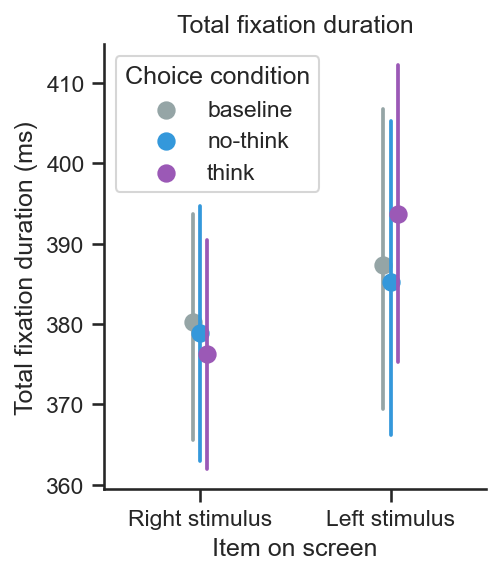

In [58]:
m_df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','fix on left_food_stimulus','fix on right_food_stimulus'],as_index=False).mean()
order = ['baseline','no-think','think']
m_df_fix_on_stim.replace({'baseline_v_baseline':'baseline','think_v_think':'think','nothink_v_nothink':'no-think'},inplace=True)
m_df_fix_on_stim.replace({True:'Left stimulus',False:'Right stimulus'},inplace=True)
plt.figure(dpi=150,figsize=(3.5,4))
ax = sns.pointplot(x='fix on left_food_stimulus',y='duration',hue='choiceCondition',dodge=True,join=False,errwidth=1.8,ci=68,data=m_df_fix_on_stim,hue_order=order,legend_out=True)
plt.ylabel('Total fixation duration (ms)')
plt.xlabel('Item on screen')
plt.title('Total fixation duration')
leg_handles = ax.get_legend_handles_labels()[0]
ax.legend(leg_handles, order, title='Choice condition')
sns.despine()
plt.tight_layout()
plt.show()

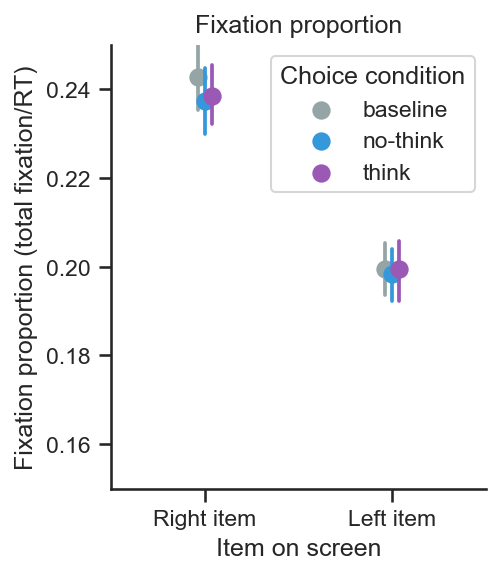

In [59]:
m_df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','fix on left_food_stimulus','fix on right_food_stimulus'],as_index=False).mean()
order = ['baseline','no-think','think']
m_df_fix_on_stim.replace({'baseline_v_baseline':'baseline','think_v_think':'think','nothink_v_nothink':'no-think'},inplace=True)
m_df_fix_on_stim.replace({True:'Left item',False:'Right item'},inplace=True)
plt.figure(dpi=150,figsize=(3.5,4))
ax = sns.pointplot(x='fix on left_food_stimulus',y='duration/RT',hue='choiceCondition',dodge=True,join=False,errwidth=1.8,ci=68,data=m_df_fix_on_stim,hue_order=order)
plt.ylim([0.15,0.25])
plt.ylabel('Fixation proportion (total fixation/RT)')
plt.xlabel('Item on screen')
plt.title('Fixation proportion')
leg_handles = ax.get_legend_handles_labels()[0]
ax.legend(leg_handles, order, title='Choice condition')
sns.despine()
plt.tight_layout()
plt.show()

### Difference in number of fixations

In [60]:
df_fix_on_stim = df.loc[(df['fix on left_food_stimulus']==True) | (df['fix on right_food_stimulus']==True)]

In [61]:
df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','trialN','fix on left_food_stimulus','fix on right_food_stimulus'],as_index=False).count() # avg within trials
df_fix_on_stim['duration/RT'] = df_fix_on_stim['duration']/df_fix_on_stim['rt']/1000

In [62]:
df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','fix on left_food_stimulus','fix on right_food_stimulus'],as_index=False).mean() # avg across trials

In [63]:
df_fix_on_stim.columns

Index(['subjid', 'choiceCondition', 'fix on left_food_stimulus',
       'fix on right_food_stimulus', 'trialN', 'Unnamed: 0_x', 'avg x pos',
       'avg y pos', 'duration', 'index', 'type', 'Unnamed: 0_y', 'leftStim',
       'leftStimRating', 'rightStim', 'rightStimRating', 'choseright', 'rt',
       'rightStimCondition', 'leftStimCondition', 'rightStimRating_z',
       'leftStimRating_z', 'deltaval', 'deltaval_z', 'absdeltaval_z',
       'condition', 'duration/RT'],
      dtype='object')

In [64]:
df_fix_on_stim.head()

,subjid,choiceCondition,fix on left_food_stimulus,fix on right_food_stimulus,trialN,Unnamed: 0_x,avg x pos,avg y pos,duration,index,...,rt,rightStimCondition,leftStimCondition,rightStimRating_z,leftStimRating_z,deltaval,deltaval_z,absdeltaval_z,condition,duration/RT
0,tnt001,baseline_v_baseline,False,True,194.336134,1.773109,1.773109,1.773109,1.773109,1.773109,...,1.773109,1.773109,1.773109,1.773109,1.773109,1.773109,1.773109,1.773109,1.773109,0.001
1,tnt001,baseline_v_baseline,True,False,194.336134,2.747899,2.747899,2.747899,2.747899,2.747899,...,2.747899,2.747899,2.747899,2.747899,2.747899,2.747899,2.747899,2.747899,2.747899,0.001
2,tnt001,nothink_v_nothink,False,True,206.168067,1.840336,1.840336,1.840336,1.840336,1.840336,...,1.840336,1.840336,1.840336,1.840336,1.840336,1.840336,1.840336,1.840336,1.840336,0.001
3,tnt001,nothink_v_nothink,True,False,206.168067,2.596639,2.596639,2.596639,2.596639,2.596639,...,2.596639,2.596639,2.596639,2.596639,2.596639,2.596639,2.596639,2.596639,2.596639,0.001
4,tnt001,think_v_nothink,False,True,203.485714,2.314286,2.314286,2.314286,2.314286,2.314286,...,2.314286,2.314286,2.314286,2.314286,2.314286,2.314286,2.314286,2.314286,2.314286,0.001


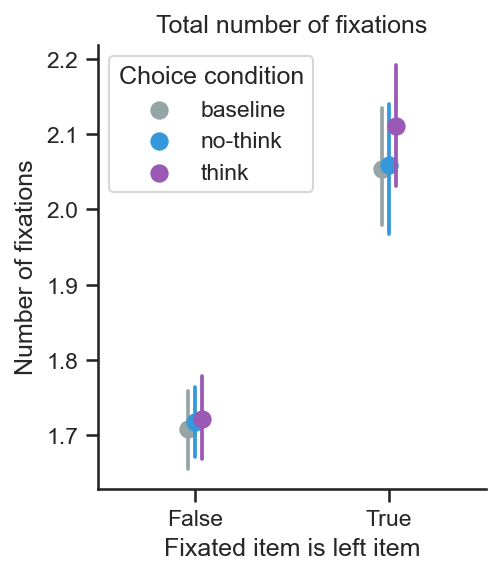

In [65]:
m_df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','fix on left_food_stimulus','fix on right_food_stimulus'],as_index=False).mean()
order = ['baseline','no-think','think']
m_df_fix_on_stim.replace({'baseline_v_baseline':'baseline','think_v_think':'think','nothink_v_nothink':'no-think'},inplace=True)
#m_df_fix_on_stim.replace({True:'Left item',False:'Right item'},inplace=True)
plt.figure(dpi=150,figsize=(3.5,4))
ax = sns.pointplot(x='fix on left_food_stimulus',y='duration',hue='choiceCondition',dodge=True,join=False,errwidth=1.8,ci=68,data=m_df_fix_on_stim,hue_order=order)
plt.ylabel('Number of fixations')
plt.xlabel('Fixated item is left item')
leg_handles = ax.get_legend_handles_labels()[0]
ax.legend(leg_handles, order, title='Choice condition')
plt.title('Total number of fixations')
sns.despine()
plt.tight_layout()
plt.show()

## Fixation difference between right and left items as a function of delta value

In [66]:
fix_data = df.groupby(['subjid','trialN','choiceCondition'],as_index=False).mean()[['subjid','trialN','choiceCondition','absdeltaval_z','rt']].copy()

In [67]:
df_fix_on_stim = df.loc[(df['fix on left_food_stimulus']==True) | (df['fix on right_food_stimulus']==True)].copy()
df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','trialN','fix on left_food_stimulus','fix on right_food_stimulus','choseright'],as_index=False).sum() # number of fixations per trials

left_fix_n = df_fix_on_stim.loc[df_fix_on_stim['fix on left_food_stimulus'] == True]
right_fix_n = df_fix_on_stim.loc[df_fix_on_stim['fix on right_food_stimulus'] == True]
fix_dur_difference = left_fix_n.merge(right_fix_n,on=["subjid","trialN","choiceCondition","choseright"],suffixes=('_left', '_right'))

fix_dur_difference['fixation duration difference'] = fix_dur_difference['duration_right'] - fix_dur_difference['duration_left'] 
fix_dur_difference.loc[fix_dur_difference['choseright']==False,'fixation duration difference'] = -fix_dur_difference.loc[fix_dur_difference['choseright']==False,'fixation duration difference']

fix_dur_difference = fix_dur_difference[["subjid","trialN","choiceCondition","fixation duration difference"]]


fix_dur_difference.head()

,subjid,trialN,choiceCondition,fixation duration difference
0,tnt001,1.0,baseline_v_baseline,169.0
1,tnt001,3.0,baseline_v_baseline,-266.0
2,tnt001,5.0,baseline_v_baseline,-0.0
3,tnt001,7.0,baseline_v_baseline,116.0
4,tnt001,12.0,baseline_v_baseline,568.0


In [68]:
df_fix_on_stim = df.loc[(df['fix on left_food_stimulus']==True) | (df['fix on right_food_stimulus']==True)].copy()
df_fix_on_stim = df_fix_on_stim.groupby(['subjid','choiceCondition','trialN','fix on left_food_stimulus','fix on right_food_stimulus','choseright'],as_index=False).count() # number of fixations per trials

left_fix_n = df_fix_on_stim.loc[df_fix_on_stim['fix on left_food_stimulus'] == True]
right_fix_n = df_fix_on_stim.loc[df_fix_on_stim['fix on right_food_stimulus'] == True]

fix_n_difference = left_fix_n.merge(right_fix_n,on=["subjid","trialN","choiceCondition","choseright"],suffixes=('_left', '_right'))
fix_n_difference['fixation number difference'] = fix_n_difference['duration_right'] - fix_n_difference['duration_left'] # using duration because just looking at count
fix_n_difference.loc[fix_n_difference['choseright']==False,'fixation number difference'] = -fix_n_difference.loc[fix_n_difference['choseright']==False,'fixation number difference']

fix_n_difference = fix_n_difference[["subjid","trialN","choiceCondition","fixation number difference"]]

fix_n_difference.head()

,subjid,trialN,choiceCondition,fixation number difference
0,tnt001,1.0,baseline_v_baseline,0
1,tnt001,3.0,baseline_v_baseline,-3
2,tnt001,5.0,baseline_v_baseline,1
3,tnt001,7.0,baseline_v_baseline,-1
4,tnt001,12.0,baseline_v_baseline,2


In [69]:
fix_data = fix_data.merge(fix_dur_difference,on=["subjid","trialN","choiceCondition"])
fix_data = fix_data.merge(fix_n_difference,on=["subjid","trialN","choiceCondition"])

In [70]:
fix_data['fixation proportion difference'] = fix_data['fixation duration difference']/fix_data['rt']/1000

In [71]:
fix_data.head()

,subjid,trialN,choiceCondition,absdeltaval_z,rt,fixation duration difference,fixation number difference,fixation proportion difference
0,tnt001,0.0,nothink_v_nothink,1.94,1.5616,350.0,3,0.224129
1,tnt001,1.0,baseline_v_baseline,2.14,1.1445,169.0,0,0.147663
2,tnt001,2.0,nothink_v_nothink,0.91,1.0952,110.0,1,0.100438
3,tnt001,3.0,baseline_v_baseline,2.58,1.1453,-266.0,-3,-0.232254
4,tnt001,4.0,think_v_think,0.42,1.3618,-300.0,-1,-0.220297


In [72]:
#from https://stackoverflow.com/questions/37765197/darken-or-lighten-a-color-in-matplotlib
def lighten_color(color, amount=0.5):
    """
    Lightens the given color by multiplying (1-luminosity) by the given amount.
    Input can be matplotlib color string, hex string, or RGB tuple.

    Examples:
    >> lighten_color('g', 0.3)
    >> lighten_color('#F034A3', 0.6)
    >> lighten_color((.3,.55,.1), 0.5)
    """
    import matplotlib.colors as mc
    import colorsys
    try:
        c = mc.cnames[color]
    except:
        c = color
    c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])

In [73]:
def sortedFunc(x, y, func):
    unique_y = np.sort(np.unique(y))
    ny = len(unique_y)

    out_x = np.empty(ny)
    counts_y = np.empty(ny)
    for i, j in zip(range(ny), unique_y):
        out_x[i] = getattr(np, func)(np.array(x)[np.array(y) == j])
        counts_y[i] = np.sum(np.array(y) == j)

    return(np.column_stack([unique_y, out_x, counts_y]))

In [74]:
def binFixData(choices):
    subjids = np.unique(choices['subjid'].values)
    
    control = pd.DataFrame()
    memory = pd.DataFrame()
    imag = pd.DataFrame()
    
    allsub_dfs = [control, memory, imag]
    
    for subjid in subjids:
        sub_bb = choices.loc[choices['choiceCondition']=='baseline_v_baseline']
        sub_tt = choices.loc[choices['choiceCondition']=='think_v_think']
        sub_ntnt = choices.loc[choices['choiceCondition']=='nothink_v_nothink']

        dfs = [sub_bb,sub_tt,sub_ntnt]
        for i in range(len(dfs)):
            sub_food = dfs[i]
            deltabins = pd.qcut(sub_food['absdeltaval_z'], 6, duplicates = 'drop')
            sub_food = sub_food.set_index(deltabins)
            sub_food['deltaval_bin'] = sub_food['absdeltaval_z']
            j = 0
            for interval in deltabins.unique():
                foodbin = sub_food.loc[interval]['deltaval_bin']
                foodbinmean = foodbin.mean()
                sub_food.loc[interval, 'deltaval_bin'] = foodbinmean
                sub_food.loc[interval, 'binN'] = j
                j+=1
            sub_df = sub_food.reset_index(drop=True)
            allsub_dfs[i] = pd.concat([allsub_dfs[i],sub_df], axis = 0)

    return allsub_dfs[0], allsub_dfs[1], allsub_dfs[2]

In [75]:
# adapted choice plots
def plotFixData(bb_data, plot_bb, tt_data, plot_tt, ntnt_data, plot_ntnt, title):
    """
    Plot raw behavioral data 

    Parameters
    ----------
    data : 2D array of shape (N, 4) where N is total number of trials
           and the columns correspond to stim_strength, rt, and choice, subjid

    Returns
    -------

    """
    
    global flatui
    colors = sns.color_palette(flatui)

    fig = plt.figure(dpi=200, figsize=(10,6))
    
    ax_choice = fig.add_subplot(1, 2, 1)
    plt.subplots_adjust(wspace=0.4)
    plt.title('Number of fixations')
    ax_choice.set_xlabel('Absolute delta value')
    ax_choice.set_ylabel('Difference in number of fixations (chosen - unchosen)')

    ax_rt = fig.add_subplot(1, 2, 2)
    plt.title('Proportion fixation time')

    ax_rt.set_xlabel('Absolute delta value')
    ax_rt.set_ylabel('Difference in proportion fixation time (chosen - unchosen)')
    
    ms = 6 # marker size
    
    if plot_bb:
        color = colors[0]
        bin_numbers, meanprop, semprop, meanrt_both, semrt_both, binvalues = getBinnedDataForPlotting(bb_data)
        ax_choice.errorbar(binvalues, meanprop, yerr=semprop, markeredgecolor=color,markerfacecolor=lighten_color(color,0.6),ecolor=color,
                           linestyle='None', capsize=0, marker='o',ms=ms, label="baseline_v_baseline")
        ax_rt.errorbar(binvalues, meanrt_both, yerr=semrt_both,markerfacecolor=lighten_color(color,0.6), 
                       markeredgecolor=color, linestyle='None', marker='o', capsize=0, ms=ms, label="baseline")
    
    if plot_ntnt:
        color = colors[1]
        bin_numbers, meanprop, semprop, meanrt_both, semrt_both, binvalues = getBinnedDataForPlotting(ntnt_data)
        ax_choice.errorbar(binvalues, meanprop, yerr=semprop, markeredgecolor=color,markerfacecolor=lighten_color(color,0.6),ecolor=color,
                           linestyle='None', capsize=0, marker='o', ms=ms,label="nothink_v_nothink")
        ax_rt.errorbar(binvalues, meanrt_both, yerr=semrt_both,markerfacecolor=lighten_color(color,0.6),ecolor=color,
                       markeredgecolor=color, linestyle='None', marker='o', capsize=0, ms=ms, label="no-think")
        
    if plot_tt:
        color = colors[2]
        bin_numbers, meanprop, semprop, meanrt_both, semrt_both, binvalues = getBinnedDataForPlotting(tt_data)
        ax_choice.errorbar(binvalues, meanprop, yerr=semprop, markeredgecolor=color,markerfacecolor=lighten_color(color,0.6),ecolor=color,
                           linestyle='None', capsize=0, marker='o', ms=ms,label="think_v_think")
        ax_rt.errorbar(binvalues, meanrt_both, yerr=semrt_both,markerfacecolor=lighten_color(color,0.6),ecolor=color,
                       markeredgecolor=color, linestyle='None', marker='o', capsize=0, ms=ms, label="think")
    
    

    lgd = plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    
    sns.despine(offset=5)
    
    suptitle = plt.suptitle(title)
    plt.tight_layout()
    plt.subplots_adjust(top=0.90)
    
    #figname = 'TNTVD_fixations_as_func_of_deltaval_' + title.replace(' ','')
    #plt.savefig('./figures/%s'%(figname), bbox_extra_artists=(lgd,suptitle), bbox_inches='tight', dpi=800)
    plt.show()

In [76]:
# adapted choice plots
def getBinnedDataForPlotting(data):
    stim_strengths, rt, ci, subj, binN = data[:, 0], data[:, 1], data[:, 2], data[:, 3], data[:,4]
    
    ustim_strengths = np.unique(stim_strengths)
    meanprop = sortedFunc(ci, binN, 'mean')[:, 1]
    
    df=pd.DataFrame(data,columns=['stim_strength','rt','ci','subj','binN'])  
    df['ci']=df['ci'].astype('float64')
    df['rt']=df['rt'].astype('float64')
    df['stim_strength']=df['stim_strength'].astype('float64')
    
    bin_numbers = df['binN'].unique()
    binvalues=df.groupby('binN',as_index=False).median()['stim_strength']
    
    smean = df.groupby(['subj','binN'],as_index=False).mean()
    semprop = smean.groupby('binN').sem()['ci']
    
    #chose right or chose left
    cr=df[df['ci']==1]
    cl=df[df['ci']==0]
    
    #means per participant per stim_strenght
    scrmeans=cr.groupby(['subj','binN'],as_index=False).mean()
    sclmeans=cl.groupby(['subj','binN'],as_index=False).mean()
    bothmeans=df.groupby(['subj','binN'],as_index=False).mean()
    del sclmeans['ci'] 
    del scrmeans['ci'] 
    del bothmeans['ci']     
    
    meanrt_lo=cl.groupby(['binN'],as_index=False).mean()['rt']
    meanrt_up=cr.groupby(['binN'],as_index=False).mean()['rt']
    meanrt_both=bothmeans.groupby(['binN'],as_index=False).mean()['rt']
    
    semrt_lo=sclmeans.groupby('binN').sem()['rt']
    semrt_up=scrmeans.groupby('binN').sem()['rt']
    semrt_both=bothmeans.groupby('binN').sem()['rt']
    
    return bin_numbers, meanprop, semprop, meanrt_both, semrt_both, binvalues

In [77]:
def getDataFixPlot(data):
    dataplot=np.column_stack([data['absdeltaval_z'],data['fixation proportion difference'],data['fixation number difference'],data['subjid'],data['binN']])
    return dataplot

In [78]:
[bb_fix,tt_fix,ntnt_fix]=binFixData(fix_data)

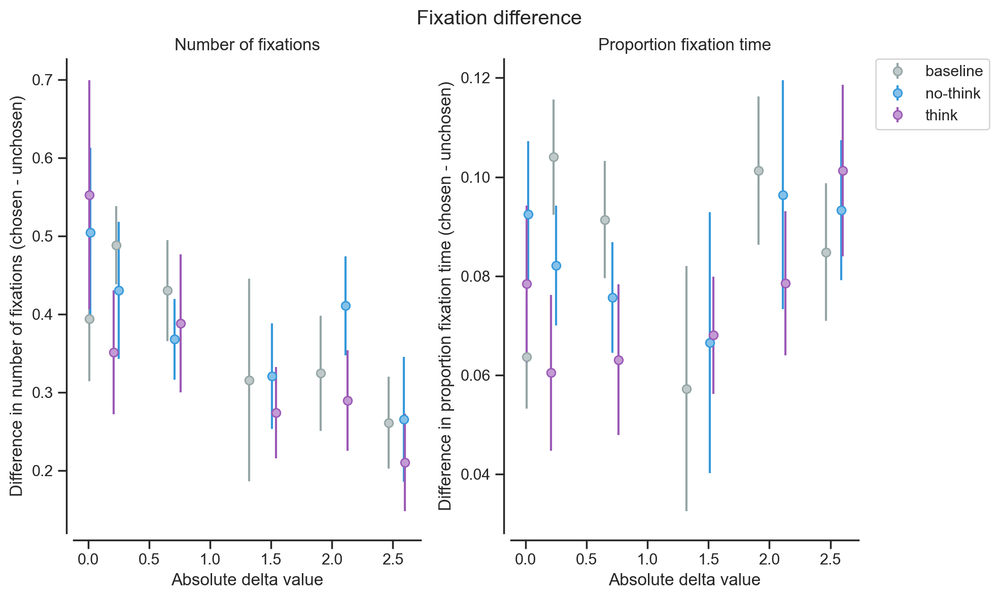

In [79]:
bb_fix_plot = getDataFixPlot(bb_fix)
tt_fix_plot = getDataFixPlot(tt_fix)
ntnt_fix_plot = getDataFixPlot(ntnt_fix)

plotFixData(bb_fix_plot,True,tt_fix_plot,True,ntnt_fix_plot,True, 'Fixation difference')